In [1]:
!pip install -q pysndfx SoundFile audiomentations pretrainedmodels efficientnet_pytorch resnest

You should consider upgrading via the '/usr/bin/python3.6 -m pip install --upgrade pip' command.


In [2]:
import argparse
import os
import sys
import yaml
from torch.utils.data import DataLoader
from tqdm import tqdm
import torch
from resnest.torch import resnest50
import resnest.torch as resnest_torch
from torch.optim import lr_scheduler
import torch.optim as optim
from torch.cuda.amp import GradScaler, autocast
import numpy as np
import time
import warnings
import torch.nn.functional as F
from sklearn.metrics import f1_score
import torch.nn as nn
import random

In [3]:
def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
seed_everything()

In [4]:
batch_size = 16
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#device = torch.device('cpu')
epochs = 7

In [5]:
from torch.utils.data import Dataset, DataLoader
import torch
import numpy as np
import os
import pickle

class BirdCallDataset(Dataset):
    
    def __init__(self, pkl_list):
        pkl_dic = dict()
        num_all_file = 0
        self.dataset=list()
        for pkl in pkl_list:
            print(f'File_{pkl} Loading...')
            with open(pkl, 'rb') as f:
                temp = pickle.load(f)
                for bird in temp:
                    self.dataset.append(bird)
                pkl_dic[pkl] = len(temp)
                num_all_file += len(temp)
        self.pkl_dic = pkl_dic
        self.num_all_file = num_all_file
        
    def __len__(self):
        return self.num_all_file
    
    
    def __getitem__(self, idx):
        wav = self.dataset[idx][0]#[np.newaxis,:,:]
        wav = self.normalize(wav)
        bird = self.dataset[idx][1]
        return (wav,bird)
    
    def normalize(self,image):
        image = image.astype("float32", copy=False) / 255.0
        image = np.stack([image, image, image])
        return image

class Averager(object):
    """Compute average for torch.Tensor, used for loss average."""

    def __init__(self):
        self.reset()

    def add(self, v):
        count = v.data.numel()
        v = v.data.sum()
        self.n_count += count
        self.sum += v

    def reset(self):
        self.n_count = 0
        self.sum = 0

    def val(self):
        res = 0
        if self.n_count != 0:
            res = self.sum / float(self.n_count)
        return res

In [6]:
class LittleModel(nn.Module):
    def __init__(self,name):
        super(LittleModel,self).__init__()
        self.fe = self.get_model(name)
        
    def forward(self,x):
        x = self.fe(x)
        x = F.softmax(x)
        return x
        

    def get_model(self, name, num_classes=397):
        """
        Loads a pretrained model. 
        Supports ResNest, ResNext-wsl, EfficientNet, ResNext and ResNet.

        Arguments:
            name {str} -- Name of the model to load

        Keyword Arguments:
            num_classes {int} -- Number of classes to use (default: {1})

        Returns:
            torch model -- Pretrained model
        """
        if "resnest" in name:
            model = getattr(resnest_torch, name)(pretrained=True)
        elif "wsl" in name:
            model = torch.hub.load("facebookresearch/WSL-Images", name)
        elif name.startswith("resnext") or  name.startswith("resnet"):
            model = torch.hub.load("pytorch/vision:v0.6.0", name, pretrained=True)
        elif name.startswith("tf_efficientnet_b"):
            model = getattr(timm.models.efficientnet, name)(pretrained=True)
        elif "efficientnet-b" in name:
            model = EfficientNet.from_pretrained(name)
        else:
            model = pretrainedmodels.__dict__[name](pretrained='imagenet')

        if hasattr(model, "fc"):
            nb_ft = model.fc.in_features
            model.fc = nn.Linear(nb_ft, num_classes)
        elif hasattr(model, "_fc"):
            nb_ft = model._fc.in_features
            model._fc = nn.Linear(nb_ft, num_classes)
        elif hasattr(model, "classifier"):
            nb_ft = model.classifier.in_features
            model.classifier = nn.Linear(nb_ft, num_classes)
        elif hasattr(model, "last_linear"):
            nb_ft = model.last_linear.in_features
            model.last_linear = nn.Linear(nb_ft, num_classes)

        return model

In [7]:
path = './train_data/'
pkl_list = [os.path.join(path,i) for i in os.listdir(path) if i.split('.')[-1]=='pkl']

train_dataset = BirdCallDataset(['./train_data/temp_2-003.pkl',\
                                 './train_data/temp_0-004.pkl',\
                                './train_data/temp_1-002.pkl'])
valid_dataset = BirdCallDataset(['./train_data/temp_3.pkl'])
train_dataloader = DataLoader(train_dataset,batch_size=batch_size,shuffle=True)
valid_dataloader = DataLoader(valid_dataset,batch_size=batch_size,shuffle=True)


File_./train_data/temp_2-003.pkl Loading...
File_./train_data/temp_0-004.pkl Loading...
File_./train_data/temp_1-002.pkl Loading...
File_./train_data/temp_3.pkl Loading...


In [10]:

from torch.cuda.amp import GradScaler, autocast
from utils.loss import AsymmetricLoss
from utils.ema import ModelEma
from torch.optim import lr_scheduler


model = LittleModel('resnest50')
#model = getattr(resnest_torch, 'resnest50')(pretrained=False, num_classes=397)
#model.load_state_dict(torch.load('./result/resnest50_pri2.pth',map_location=device))
model.to(device)


filtered_parameters = []
params_num = []

for p in filter(lambda p: p.requires_grad, model.parameters()):
    filtered_parameters.append(p)
    params_num.append(np.prod(p.size()))
print('Trainable params num : ', sum(params_num))

'''
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(filtered_parameters, lr=8e-4)
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, eta_min=1e-5, T_max=epochs)
loss_avg = Averager()
'''

learning_rate=0.003
optimizer = optim.Adam(filtered_parameters, lr=learning_rate, betas=(0.9, 0.999))
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, eta_min=1e-5, T_max=epochs)
loss_avg = Averager()
#criterion = AsymmetricLoss(gamma_neg=4, gamma_pos=0, clip=0.05, disable_torch_grad_focal_loss=True)
criterion = nn.CrossEntropyLoss().to(torch.float)

best_loss = 100
val_loss = 0
for epoch in range(epochs):
    with tqdm(train_dataloader,unit="Batch") as tepoch:
        model.train()

        for batch,data in enumerate(tepoch):
            tepoch.set_description(f" Epoch {epoch+1} : Batch {batch+1} / {len(train_dataloader)} ")

            wav, bird = data

            wav = wav.to(torch.float32)
            wav = wav.to(device)
            bird_smooth = np.where(bird==1,0.995,0.0025)
            bird_smooth = torch.from_numpy(bird_smooth).to(device)

            output = model(wav).float()  # sigmoid will be done in loss !

            loss = criterion(output, torch.max(bird_smooth, 1)[1].to(torch.long))
            loss.backward()
            #loss = criterion(output, bird_smooth.to(torch.long))
            loss_avg.add(loss)

            model.zero_grad()

            optimizer.step()
            scheduler.step()

            torch.nn.utils.clip_grad_norm_(model.parameters(),5)  # gradient clipping with 5 (Default)
            #https://kh-kim.gitbook.io/natural-language-processing-with-pytorch/00-cover-6/05-gradient-clipping
            tepoch.set_postfix(loss=loss_avg.val().item(), val_loss=val_loss)

            #del wav, bird, loss, output

            if loss_avg.val().item() < best_loss and (batch+1)%50==0:
                best_loss = loss_avg.val().item()
                torch.save(model.state_dict(),'./result/resnest_cls_softmax.pth')

        model.eval()
        val_avg = Averager()

        for k, data in enumerate(tqdm(valid_dataloader)):
            wav, bird = data

            wav = wav.to(torch.float32)
            wav = wav.to(device)

            bird_smooth = np.where(bird==1,0.995,0.0025)
            bird_smooth = torch.from_numpy(bird_smooth).to(device)

            output = model(wav).float()  # sigmoid will be done in loss !

            loss = criterion(output, bird_smooth)
            val_avg.add(loss)
        val_loss = val_avg.val().item()
        model.train()

 Epoch 1 : Batch 1 / 12253 :   0%|          | 0/12253 [00:00<?, ?Batch/s]/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
 Epoch 1 : Batch 2 / 12253 :   0%|          | 1/12253 [00:00<24:38,  8.28Batch/s, loss=5.98, val_loss=0]

Trainable params num :  26247693


 Epoch 1 : Batch 154 / 12253 :   1%|          | 153/12253 [00:14<19:05, 10.57Batch/s, loss=5.98, val_loss=0]


KeyboardInterrupt: 

In [19]:
output[0,output[0].argmax()]

tensor(0.0060, device='cuda:0', grad_fn=<SelectBackward>)

In [11]:
output.shape

torch.Size([16, 397])

In [ ]:
torch.max(bird_smooth, 1)[1].to(torch.long)

In [ ]:
from torch.autograd import Variable
target = Variable(torch.FloatTensor(10).uniform_(0, 120).long())
print(target)

In [ ]:
output[3]

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(wav[3,0].cpu().detach().numpy())
plt.show()

In [ ]:
bird_smooth[3]

In [35]:
import torchlibrosa as tl

def get_feature_extractor():
    SPEC_HEIGHT = 128
    SPEC_WIDTH = 256
    NUM_MELS = SPEC_HEIGHT
    HOP_LENGTH = int(32000 * 5 / (SPEC_WIDTH - 1)) # sample rate * duration / spec width - 1 == 627
    FMIN = 500
    FMAX = 12500
    
    feature_extractor = torch.nn.Sequential(
    tl.Spectrogram(
        n_fft=2048,
        hop_length=HOP_LENGTH,
        freeze_parameters=True
    ), tl.LogmelFilterBank(
        sr=32000,
        n_mels=NUM_MELS,
        fmin=FMIN,
        fmax=FMAX,
    )).to(device)
        
    return feature_extractor

extractor = get_feature_extractor()

def mono_to_color(X, eps=1e-6, mean=None, std=None):
    mean = mean or X.mean()
    std = std or X.std()
    X = (X - mean) / (std + eps)
    
    _min, _max = X.min(), X.max()

    if (_max - _min) > eps:
        V = np.clip(X, _min, _max)
        V = 255 * (V - _min) / (_max - _min)
        V = V.astype(np.uint8)
    else:
        V = np.zeros_like(X, dtype=np.uint8)

    return V

In [36]:
import librosa
import pandas as pd

path = './asset/birdclef-2021/train_soundscapes/'
scape_list = [i for i in os.listdir(path) if i.split('.')[-1] == 'ogg']
duration = 5
sr = 32000

term = duration * sr

csv = './asset/birdclef-2021/train_soundscape_labels.csv'
df = pd.read_csv(csv)

scape_dict = {}
for name,birds in zip(df['row_id'],df['birds']):
    target = '_'.join(name.split('_')[:2])
    
    if target not in scape_dict.keys():
        scape_dict[target]=[]
        scape_dict[target].append([birds])
    else:
        scape_dict[target].append([birds])


In [37]:
def convert_to_mel(wav):
    SPEC_HEIGHT = 64
    SPEC_WIDTH = 256
    NUM_MELS = SPEC_HEIGHT
    HOP_LENGTH = int(32000 * 5 / (SPEC_WIDTH - 1)) # sample rate * duration / spec width - 1 == 627
    FMIN = 500
    FMAX = 12500
    mel_spec = librosa.feature.melspectrogram(y=wav, 
                                              sr=32000, 
                                              n_fft=1024, 
                                              hop_length=HOP_LENGTH, 
                                              n_mels=NUM_MELS, 
                                              fmin=FMIN, 
                                              fmax=FMAX)
    mel_spec = librosa.power_to_db(mel_spec, ref=np.max)
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    return mel_spec

In [38]:
def load_Metadata():
    #get list of all files with labels
    data_path = './asset/birdclef-2021/train_short_audio/'
    
    df = pd.read_csv('./asset/birdclef-2021/train_metadata.csv')
    blist=df['primary_label'].unique()
    
    call_list=list()
    for sec,pri,filename in zip(df['secondary_labels'],df['primary_label'],df['filename']):
        sec_2 = list(sec.replace("'",'').replace('[','').replace(']','').split(','))
        sec_2.append(pri)
        if sec_2[0]=='':
            sec_2=sec_2[1:]
        call_list.append([os.path.join(data_path,pri,filename),sec_2])
    
    blist=list(blist)
    
    return call_list, blist

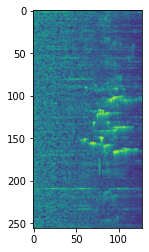

grtgra ['bkcchi grycat reevir1']


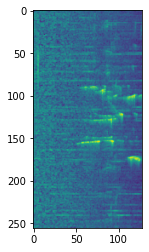

wbwwre1 ['eawpew grycat reevir1']


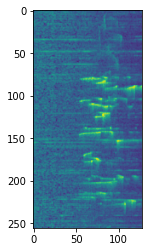

ducfly ['bkcchi eawpew grycat reevir1']


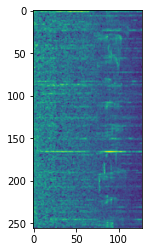

chbwre1 ['eawpew grycat reevir1']


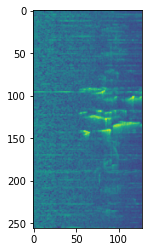

ducfly ['eawpew grycat reevir1']


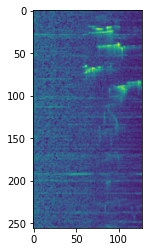

wbwwre1 ['bkcchi reevir1']


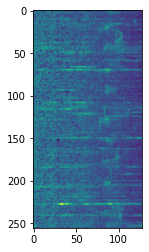

grtgra ['eawpew grycat reevir1']


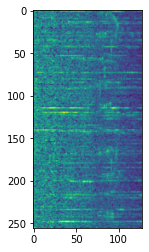

grtgra ['bkcchi eawpew grycat reevir1']


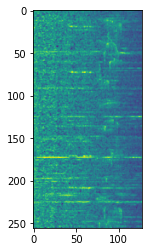

grtgra ['eawpew reevir1']


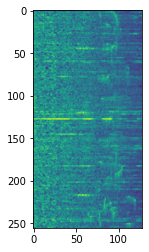

strcuc1 ['bkcchi eawpew reevir1']


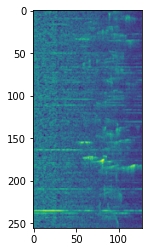

littin1 ['bkcchi eawpew reevir1']


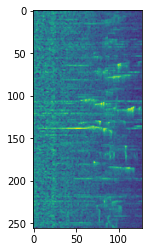

grtgra ['bkcchi eawpew reevir1']


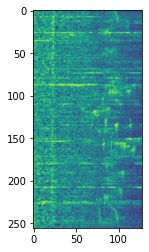

purgal2 ['bkcchi eawpew reevir1']


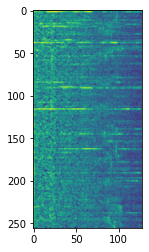

whtdov ['eawpew reevir1']


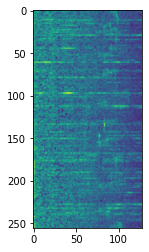

grtgra ['bkcchi eawpew grycat reevir1']


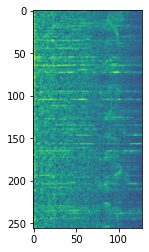

grtgra ['eawpew grycat reevir1']


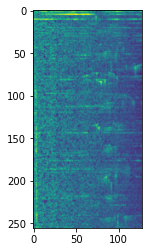

whtdov ['grycat reevir1']


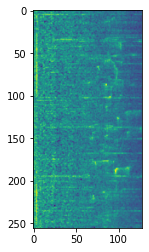

bbwduc ['eawpew grycat reevir1']


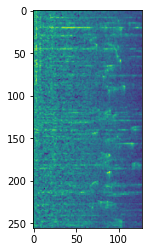

grtgra ['eawpew grycat reevir1']


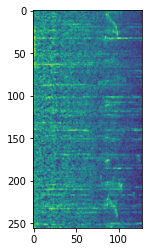

grtgra ['bkcchi reevir1']


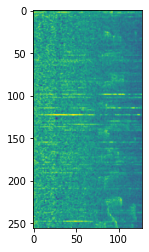

whtdov ['eawpew reevir1']


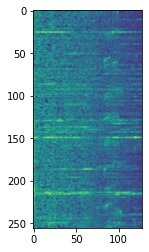

grtgra ['bkcchi eawpew reevir1']


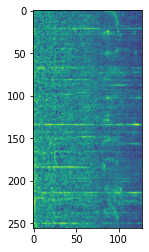

grtgra ['eawpew reevir1']


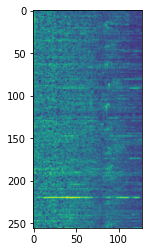

grtgra ['reevir1']


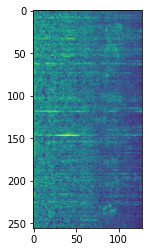

grtgra ['bkcchi eawpew reevir1']


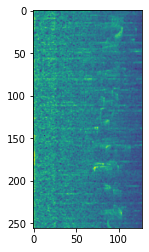

willet1 ['grycat reevir1']


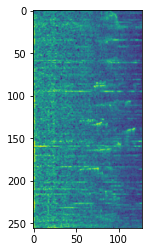

y00475 ['eawpew grycat reevir1']


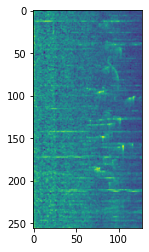

grtgra ['eawpew grycat reevir1']


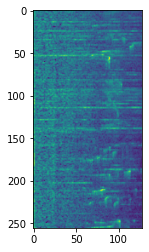

grtgra ['eawpew reevir1']


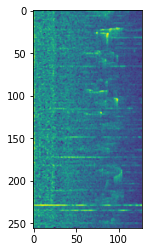

whtdov ['reevir1']


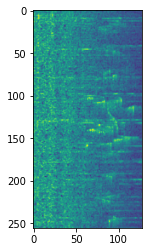

grtgra ['eawpew reevir1']


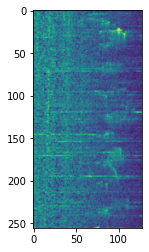

rawwre1 ['eawpew reevir1']


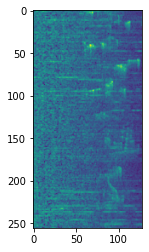

banwre1 ['reevir1']


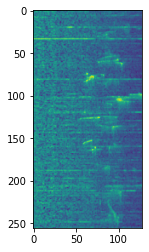

whtdov ['eawpew reevir1']


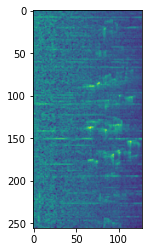

whimbr ['eawpew reevir1']


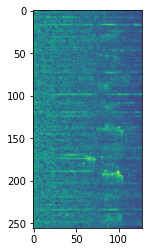

whimbr ['reevir1']


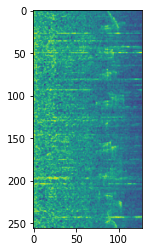

laugul ['eawpew grycat reevir1']


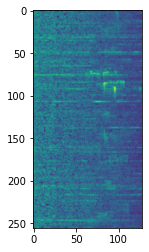

wesmea ['eawpew grycat reevir1']


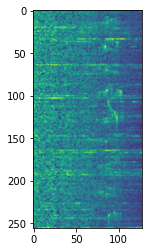

grtgra ['grycat reevir1']


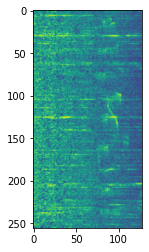

cangoo ['eawpew grycat reevir1']


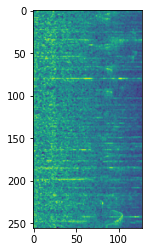

laugul ['grycat reevir1']


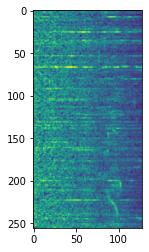

grtgra ['eawpew grycat reevir1']


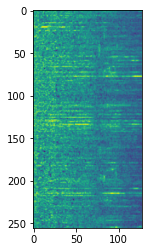

rebnut ['grycat reevir1']


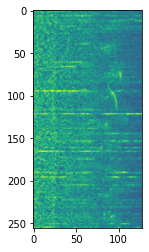

grtgra ['eawpew grycat reevir1']


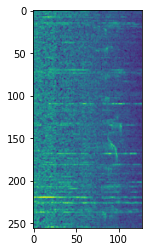

grtgra ['eawpew grycat reevir1']


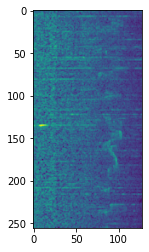

strcuc1 ['chswar eawpew grycat reevir1']


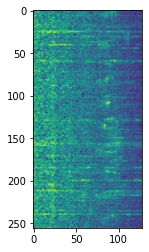

laugul ['grycat reevir1']


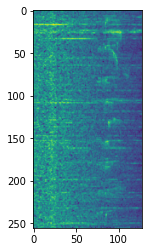

grtgra ['chswar eawpew reevir1']


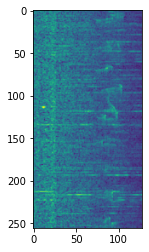

grtgra ['grycat reevir1']


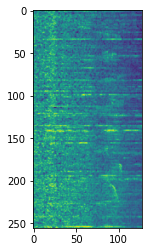

grtgra ['eawpew grycat reevir1']


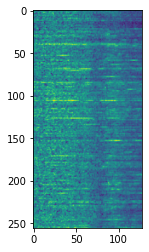

grtgra ['grycat reevir1']


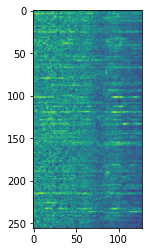

grtgra ['grycat reevir1']


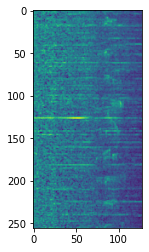

grtgra ['eawpew reevir1']


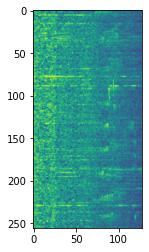

laugul ['eawpew reevir1']


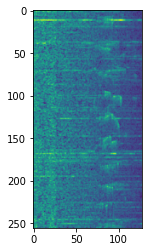

y00475 ['bkcchi grycat reevir1']


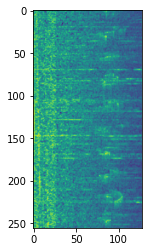

grtgra ['eawpew reevir1']


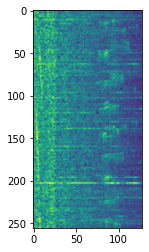

grtgra ['reevir1']


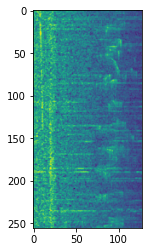

grtgra ['eawpew reevir1']


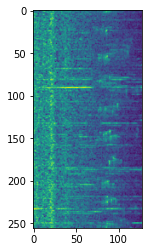

grtgra ['reevir1']


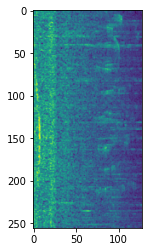

grtgra ['eawpew reevir1']


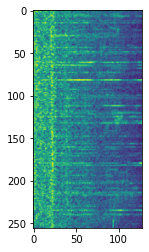

grtgra ['eawpew reevir1']


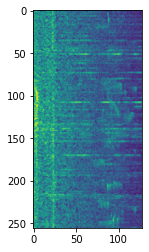

grtgra ['bkcchi reevir1']


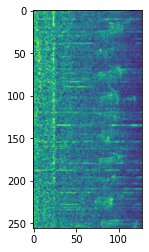

laugul ['eawpew reevir1']


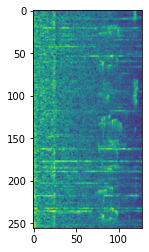

grtgra ['reevir1']


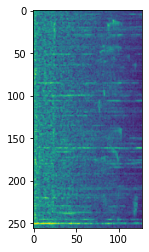

littin1 ['eawpew reevir1']


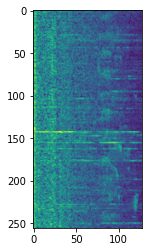

grtgra ['reevir1']


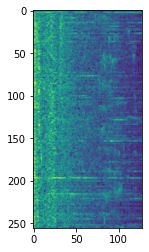

grtgra ['eawpew reevir1']


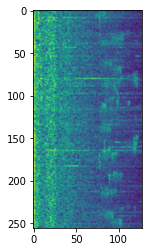

grtgra ['reevir1']


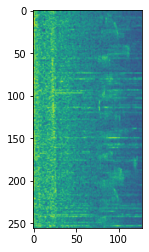

grtgra ['eawpew reevir1']


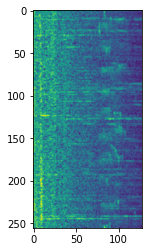

grtgra ['reevir1']


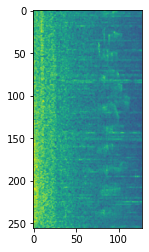

marwre ['eawpew reevir1']


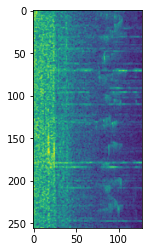

grtgra ['reevir1']


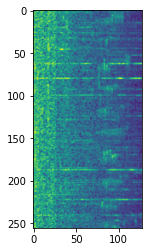

grtgra ['eawpew reevir1']


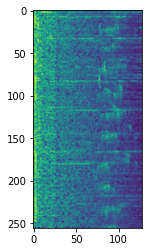

y00475 ['reevir1']


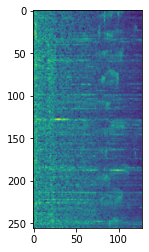

strcuc1 ['reevir1']


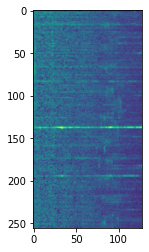

whtspa ['reevir1']


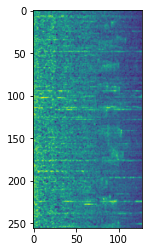

bbwduc ['eawpew reevir1']


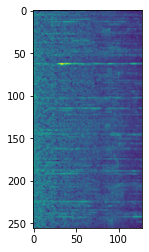

strcuc1 ['bkcchi reevir1']


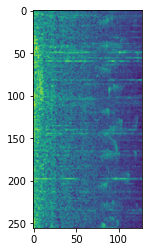

grtgra ['eawpew reevir1']


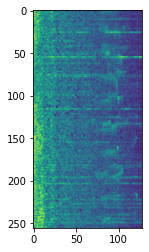

littin1 ['reevir1']


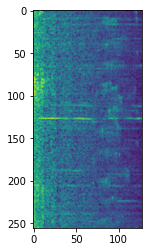

bobfly1 ['eawpew reevir1']


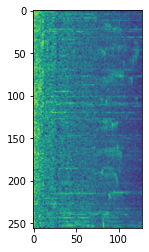

bbwduc ['reevir1']


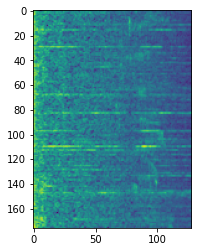

grtgra ['eawpew reevir1']


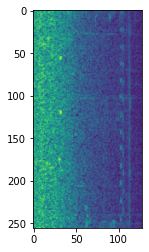

purgal2 ['nocall']


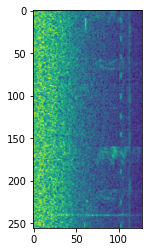

pibgre ['bobfly1']


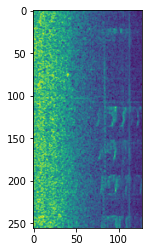

bbwduc ['nocall']


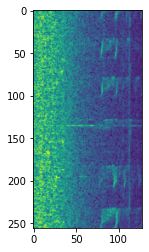

bobfly1 ['bobfly1']


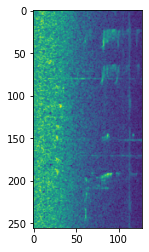

bobfly1 ['bobfly1']


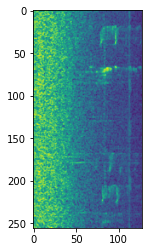

bbwduc ['bobfly1']


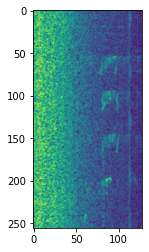

bbwduc ['bobfly1']


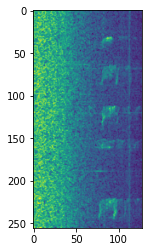

laugul ['bobfly1']


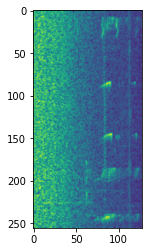

pibgre ['bobfly1']


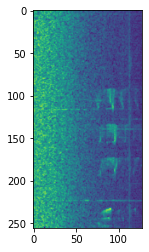

bbwduc ['bobfly1']


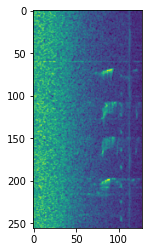

pibgre ['bobfly1']


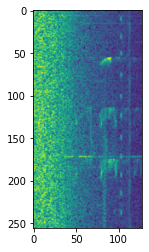

bbwduc ['bobfly1']


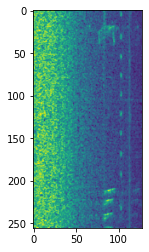

pibgre ['bobfly1']


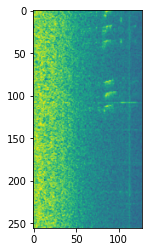

bbwduc ['bobfly1']


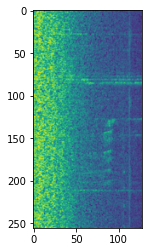

coohaw ['bobfly1']


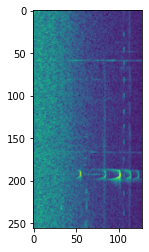

ruckin ['bobfly1']


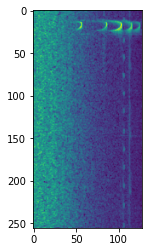

rawwre1 ['bobfly1']


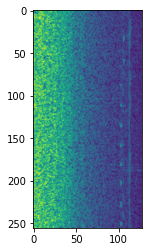

bbwduc ['nocall']


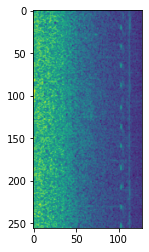

purgal2 ['bobfly1']


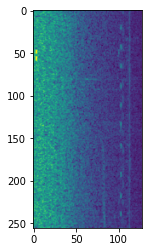

grtgra ['bobfly1']


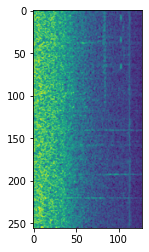

bbwduc ['nocall']


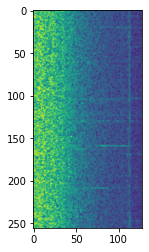

bbwduc ['bobfly1']


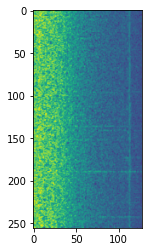

coohaw ['grekis']


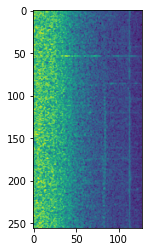

bbwduc ['grekis']


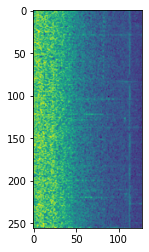

bbwduc ['nocall']


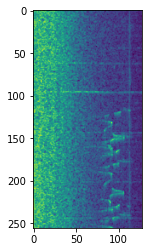

laugul ['nocall']


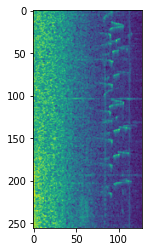

laugul ['nocall']


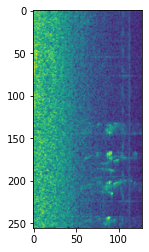

bnhcow ['nocall']


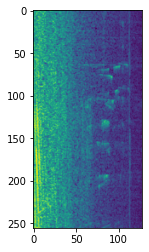

marwre ['nocall']


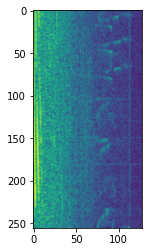

ccbfin ['nocall']


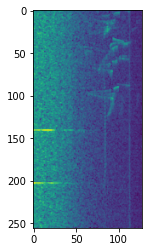

grtgra ['nocall']


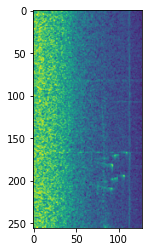

bbwduc ['nocall']


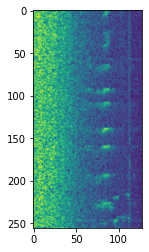

pibgre ['nocall']


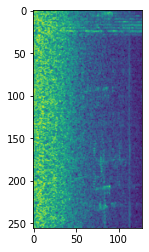

bbwduc ['nocall']


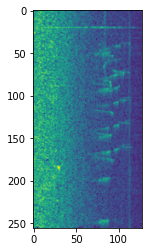

royter1 ['nocall']


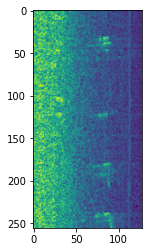

laugul ['nocall']


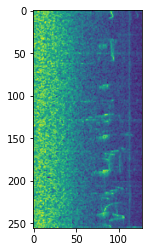

pibgre ['nocall']


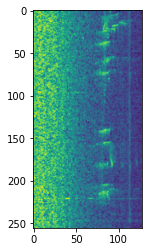

pibgre ['plawre1']


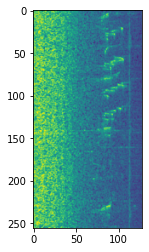

pibgre ['plawre1']


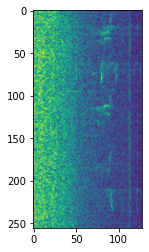

bbwduc ['bobfly1 plawre1']


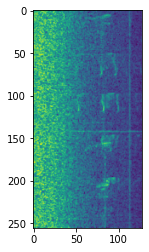

bbwduc ['bobfly1 plawre1']


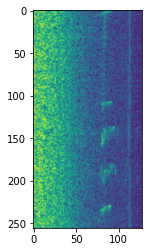

pibgre ['bobfly1 plawre1']


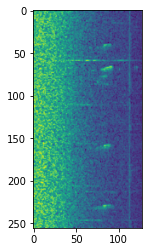

laugul ['bobfly1 plawre1']


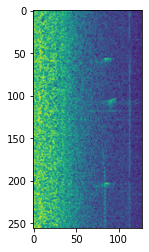

bbwduc ['bobfly1 plawre1']


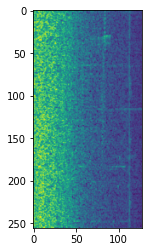

pibgre ['nocall']


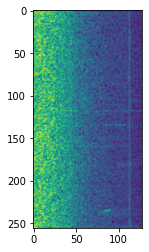

bbwduc ['plawre1']


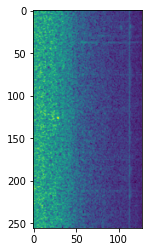

bobfly1 ['bobfly1 plawre1']


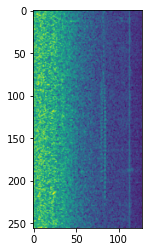

bbwduc ['bobfly1']


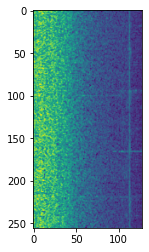

bbwduc ['nocall']


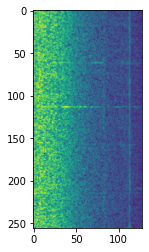

bbwduc ['plawre1']


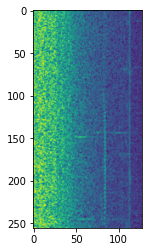

bbwduc ['bobfly1 plawre1']


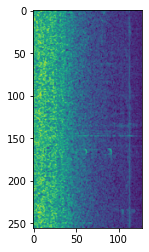

monoro1 ['bobfly1']


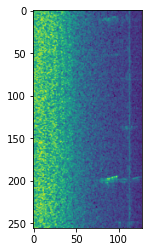

laugul ['bobfly1']


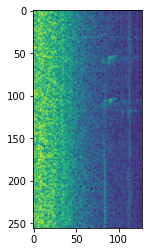

bbwduc ['bobfly1']


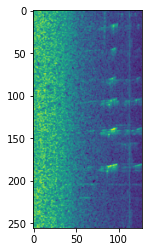

pibgre ['bobfly1']


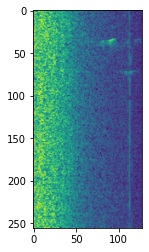

bbwduc ['bobfly1 plawre1']


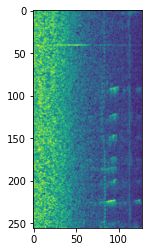

bobfly1 ['bobfly1']


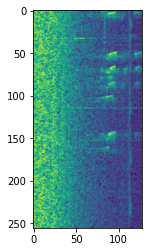

bbwduc ['bobfly1']


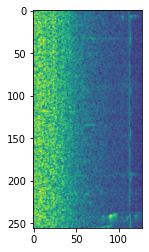

bbwduc ['bobfly1']


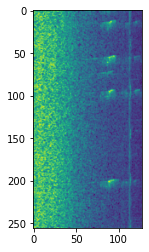

pibgre ['bobfly1']


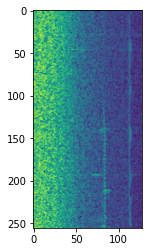

coohaw ['bobfly1']


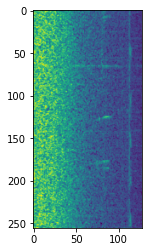

bbwduc ['bobfly1']


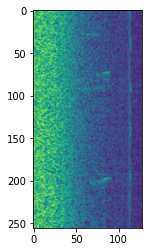

bbwduc ['bobfly1']


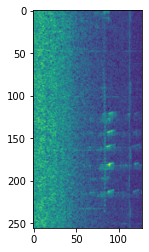

grtgra ['bobfly1']


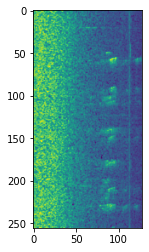

laugul ['nocall']


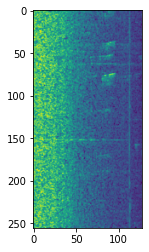

pibgre ['nocall']


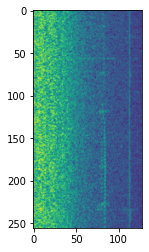

bobfly1 ['nocall']


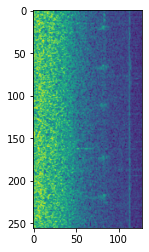

bbwduc ['nocall']


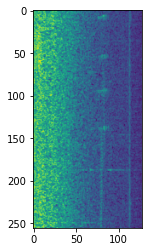

bbwduc ['nocall']


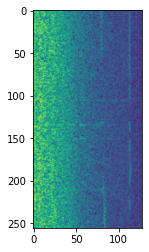

coohaw ['nocall']


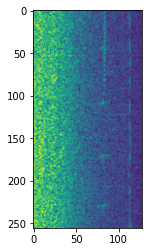

bbwduc ['nocall']


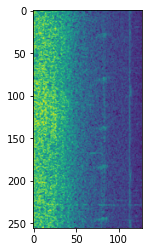

coohaw ['nocall']


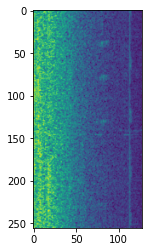

monoro1 ['nocall']


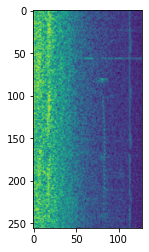

bbwduc ['nocall']


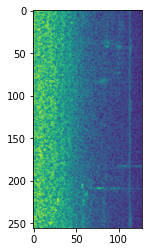

bbwduc ['nocall']


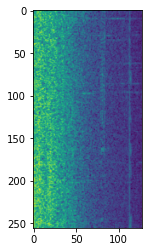

monoro1 ['nocall']


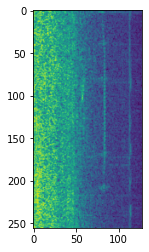

bobfly1 ['bobfly1']


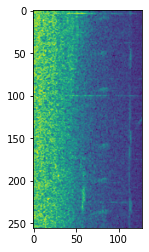

bbwduc ['bobfly1']


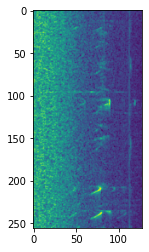

royter1 ['bobfly1']


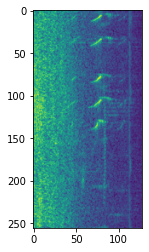

hergul ['bobfly1']


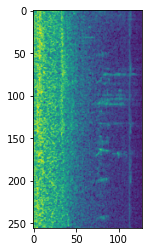

bbwduc ['nocall']


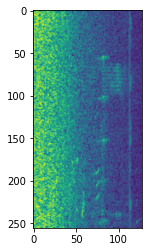

bbwduc ['bobfly1']


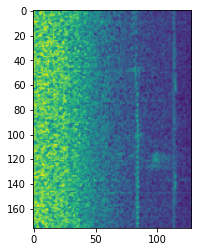

bbwduc ['bobfly1']


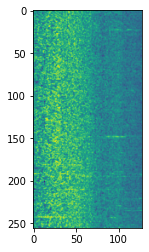

laugul ['nocall']


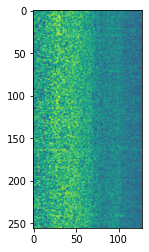

laugul ['nocall']


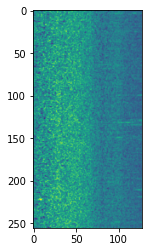

monoro1 ['nocall']


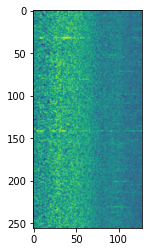

laugul ['nocall']


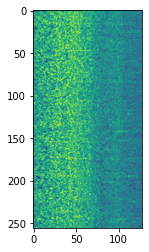

laugul ['nocall']


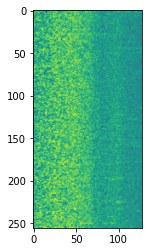

laugul ['nocall']


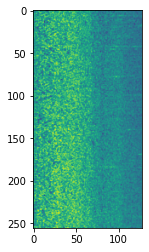

laugul ['nocall']


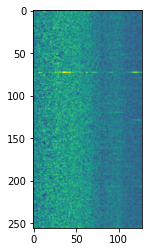

wilsni1 ['nocall']


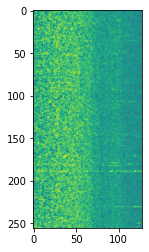

laugul ['nocall']


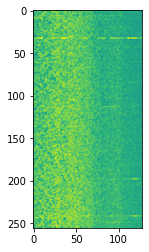

laugul ['nocall']


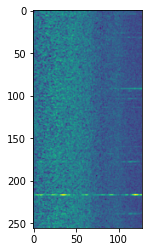

whtspa ['nocall']


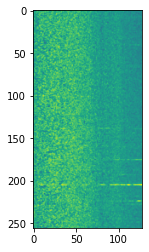

wilsni1 ['nocall']


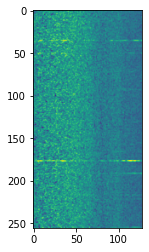

laugul ['nocall']


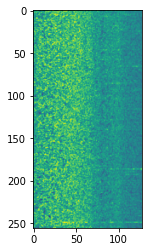

laugul ['nocall']


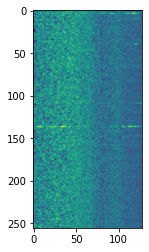

wilsni1 ['nocall']


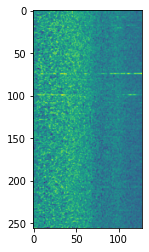

grtgra ['nocall']


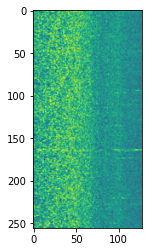

laugul ['nocall']


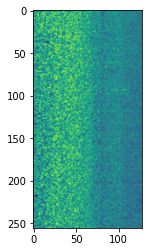

laugul ['nocall']


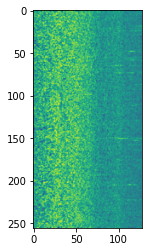

laugul ['nocall']


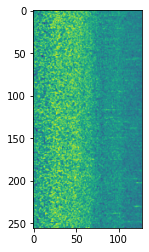

laugul ['nocall']


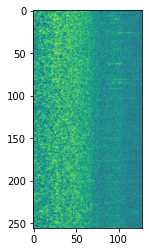

laugul ['nocall']


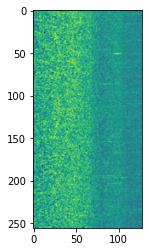

laugul ['nocall']


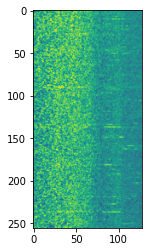

laugul ['nocall']


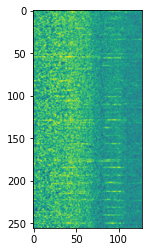

laugul ['nocall']


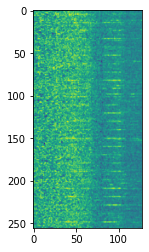

laugul ['nocall']


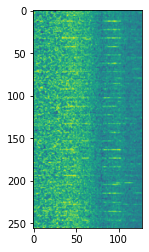

laugul ['nocall']


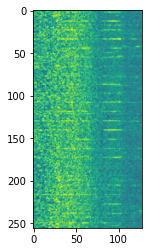

laugul ['nocall']


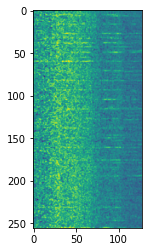

laugul ['nocall']


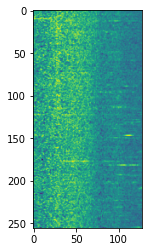

laugul ['nocall']


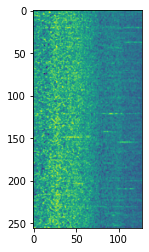

laugul ['nocall']


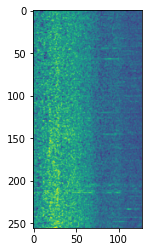

grtgra ['nocall']


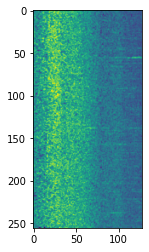

grtgra ['nocall']


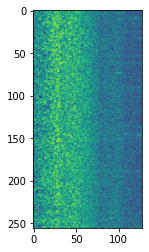

laugul ['nocall']


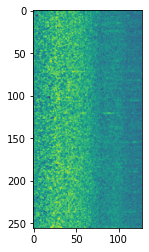

laugul ['nocall']


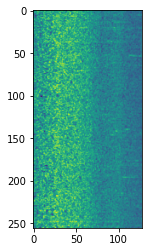

laugul ['nocall']


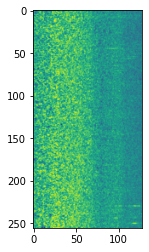

laugul ['nocall']


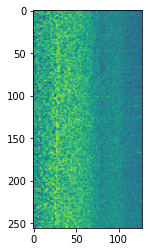

laugul ['nocall']


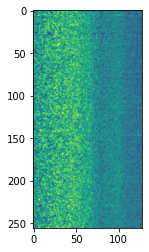

laugul ['nocall']


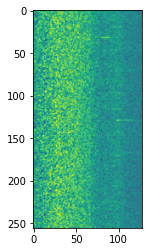

laugul ['nocall']


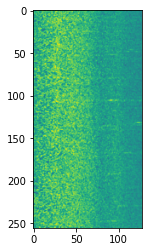

laugul ['nocall']


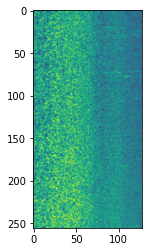

laugul ['nocall']


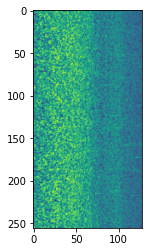

laugul ['nocall']


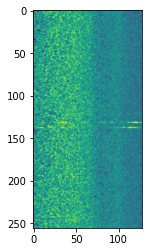

laugul ['nocall']


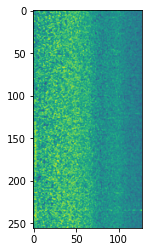

laugul ['nocall']


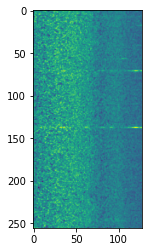

wilsni1 ['nocall']


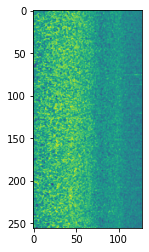

laugul ['nocall']


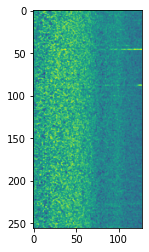

laugul ['nocall']


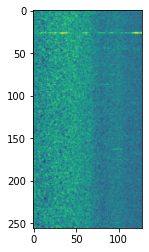

rawwre1 ['nocall']


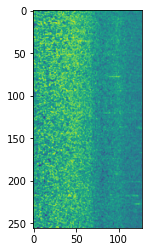

laugul ['nocall']


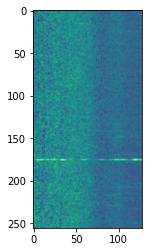

norfli ['nocall']


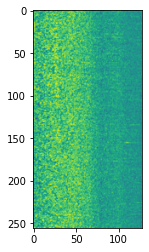

laugul ['nocall']


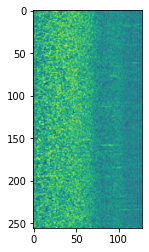

laugul ['nocall']


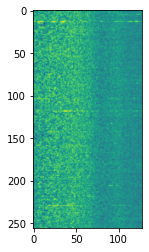

wilsni1 ['nocall']


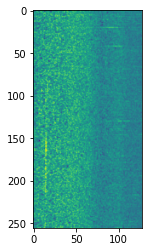

monoro1 ['nocall']


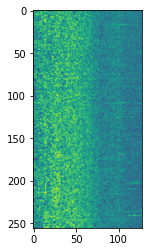

laugul ['nocall']


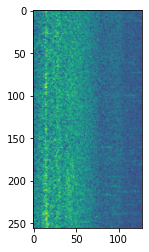

grtgra ['nocall']


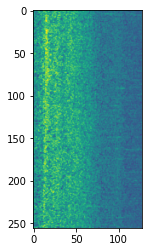

bbwduc ['nocall']


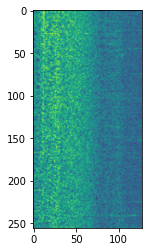

grtgra ['nocall']


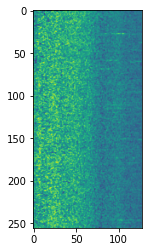

laugul ['nocall']


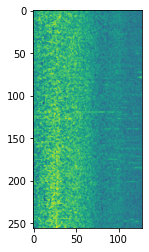

laugul ['nocall']


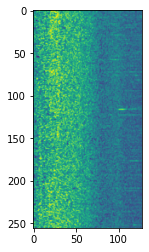

laugul ['nocall']


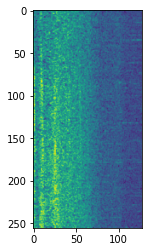

coohaw ['nocall']


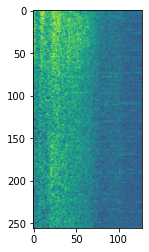

grtgra ['nocall']


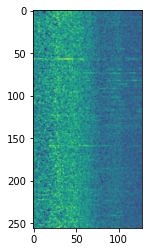

laugul ['nocall']


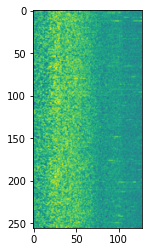

laugul ['nocall']


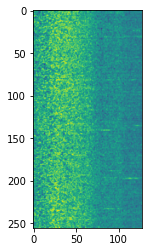

laugul ['nocall']


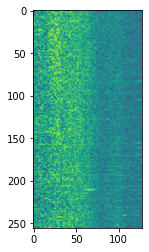

laugul ['nocall']


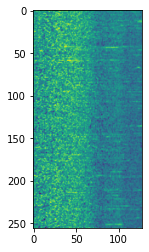

laugul ['nocall']


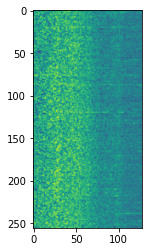

laugul ['nocall']


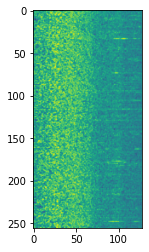

laugul ['nocall']


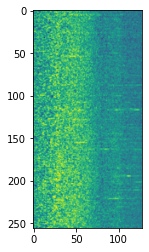

laugul ['nocall']


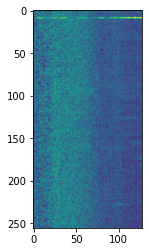

compot1 ['nocall']


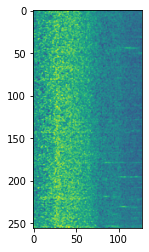

grtgra ['nocall']


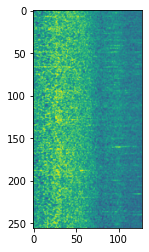

laugul ['nocall']


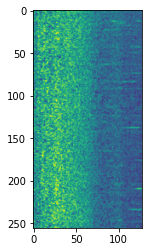

laugul ['nocall']


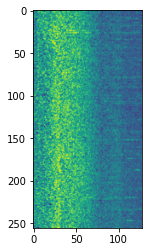

laugul ['nocall']


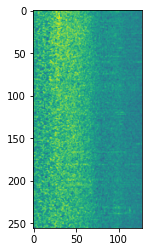

bbwduc ['nocall']


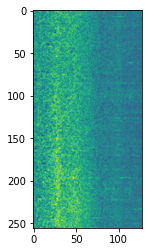

monoro1 ['nocall']


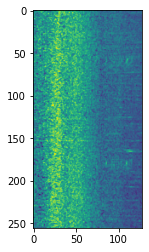

y00475 ['nocall']


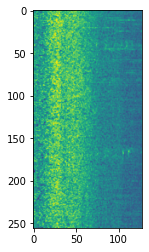

bbwduc ['nocall']


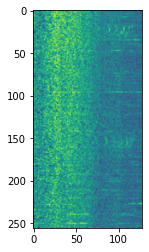

laugul ['nocall']


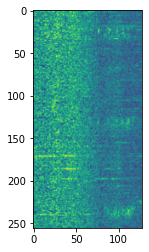

laugul ['nocall']


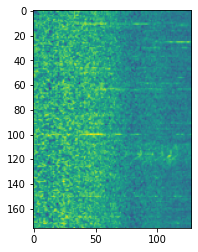

laugul ['nocall']


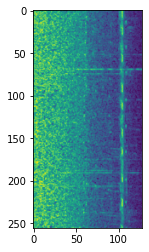

bbwduc ['nocall']


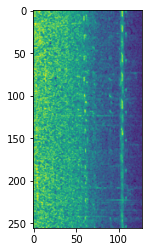

purgal2 ['nocall']


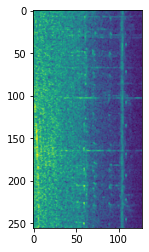

grtgra ['nocall']


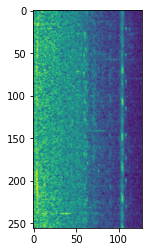

pibgre ['nocall']


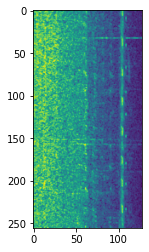

bbwduc ['nocall']


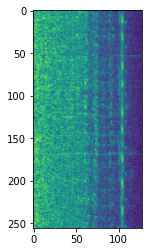

purgal2 ['nocall']


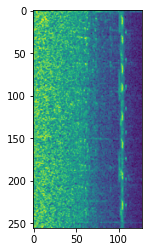

pibgre ['nocall']


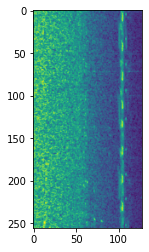

coohaw ['nocall']


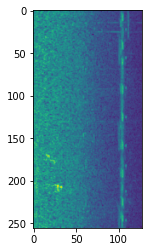

azaspi1 ['nocall']


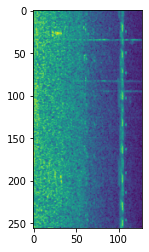

grtgra ['nocall']


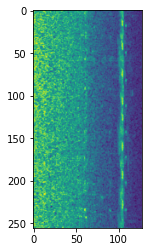

purgal2 ['nocall']


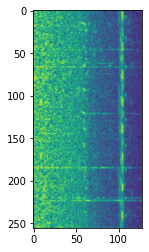

bbwduc ['nocall']


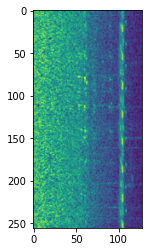

purgal2 ['nocall']


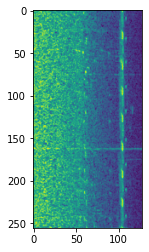

pibgre ['nocall']


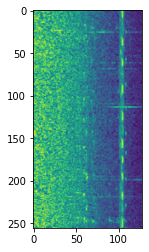

laugul ['nocall']


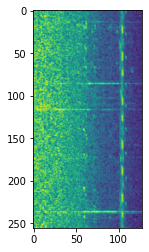

pibgre ['nocall']


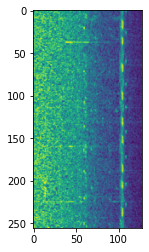

bbwduc ['nocall']


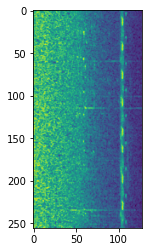

purgal2 ['nocall']


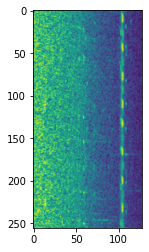

bbwduc ['nocall']


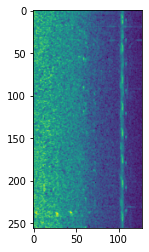

bbwduc ['nocall']


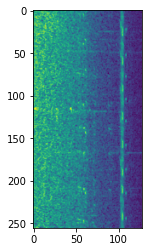

purgal2 ['nocall']


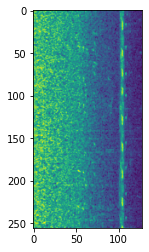

laugul ['nocall']


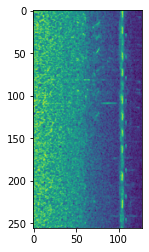

laugul ['nocall']


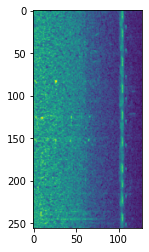

norfli ['nocall']


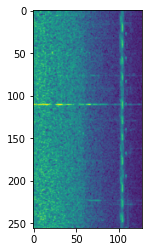

whtspa ['nocall']


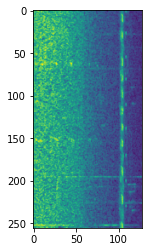

bbwduc ['nocall']


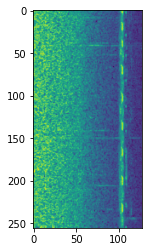

bbwduc ['nocall']


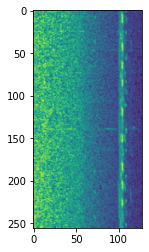

bbwduc ['nocall']


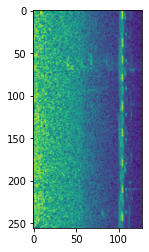

bbwduc ['nocall']


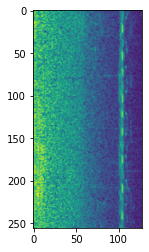

bbwduc ['nocall']


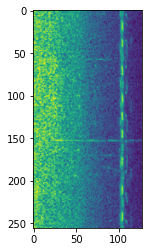

pibgre ['nocall']


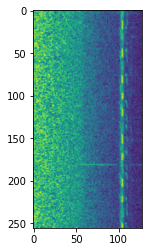

bbwduc ['nocall']


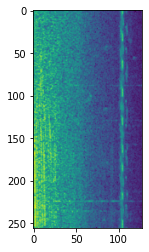

marwre ['nocall']


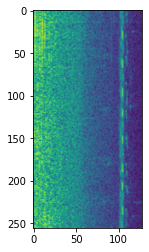

coohaw ['nocall']


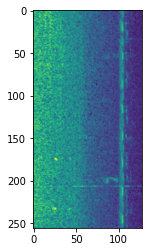

marwre ['nocall']


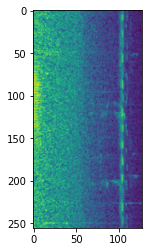

grtgra ['nocall']


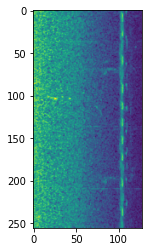

marwre ['nocall']


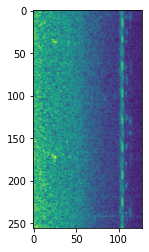

bbwduc ['nocall']


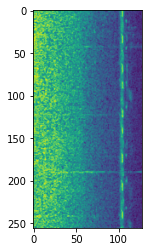

marwre ['nocall']


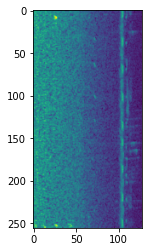

purgal2 ['nocall']


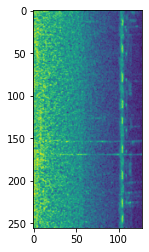

pibgre ['nocall']


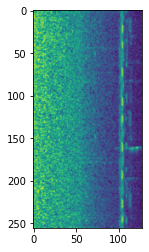

coohaw ['nocall']


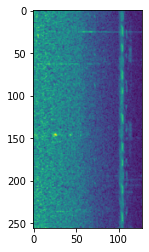

bbwduc ['nocall']


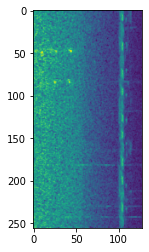

coohaw ['nocall']


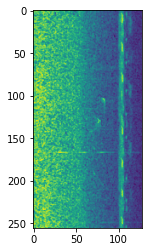

bbwduc ['nocall']


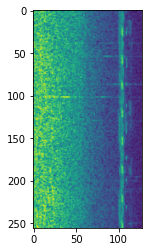

pibgre ['nocall']


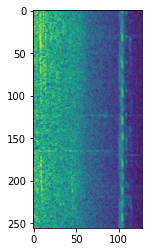

coohaw ['nocall']


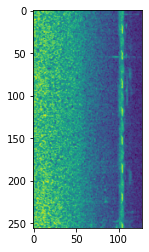

purgal2 ['nocall']


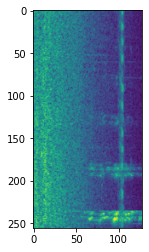

ccbfin ['nocall']


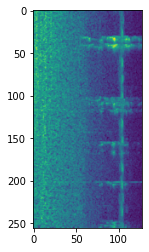

chcant2 ['nocall']


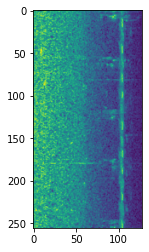

coohaw ['nocall']


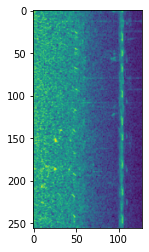

purgal2 ['nocall']


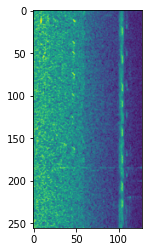

rocpig ['nocall']


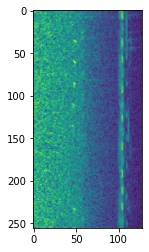

coohaw ['nocall']


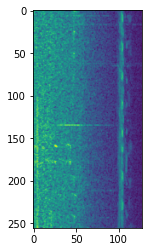

grtgra ['nocall']


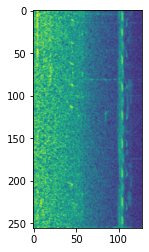

bbwduc ['nocall']


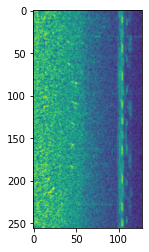

bbwduc ['nocall']


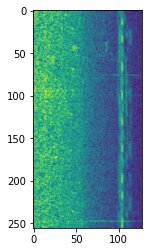

marwre ['nocall']


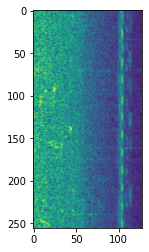

casvir ['nocall']


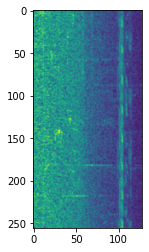

marwre ['nocall']


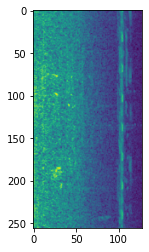

bbwduc ['nocall']


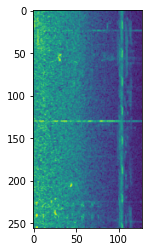

rutjac1 ['nocall']


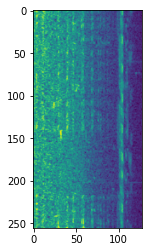

purgal2 ['nocall']


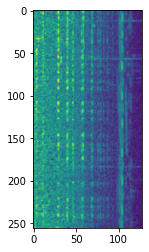

bknsti ['nocall']


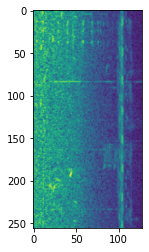

marwre ['nocall']


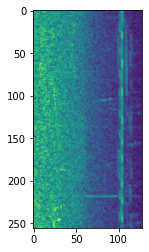

casvir ['nocall']


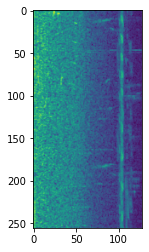

monoro1 ['nocall']


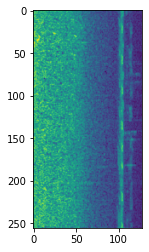

bbwduc ['nocall']


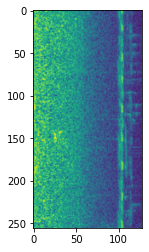

bbwduc ['nocall']


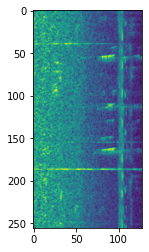

yebori1 ['nocall']


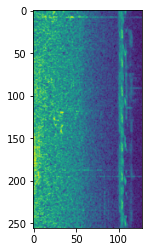

bbwduc ['orcpar']


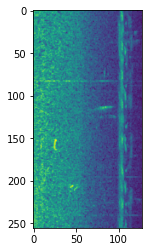

bobfly1 ['orcpar']


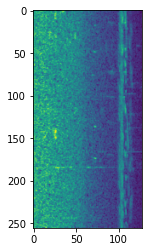

purgal2 ['orcpar']


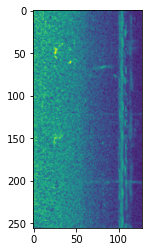

yebcha ['nocall']


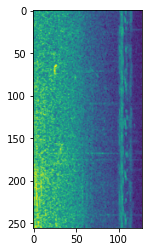

bbwduc ['nocall']


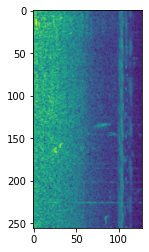

monoro1 ['nocall']


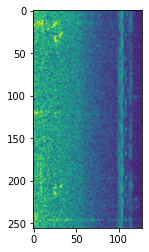

bbwduc ['nocall']


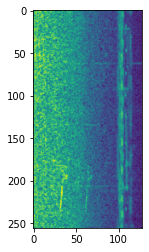

bbwduc ['nocall']


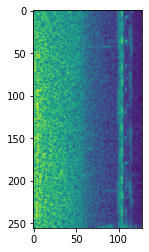

bbwduc ['nocall']


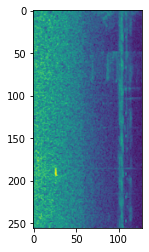

bncfly ['nocall']


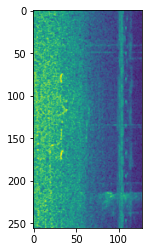

bbwduc ['nocall']


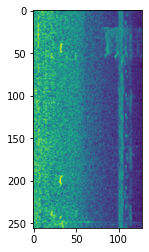

paltan1 ['nocall']


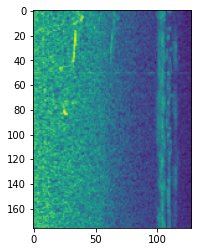

bbwduc ['nocall']


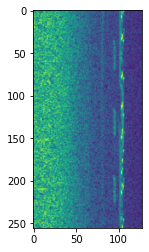

pibgre ['nocall']


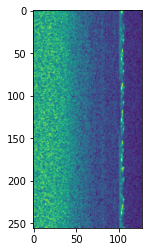

purgal2 ['nocall']


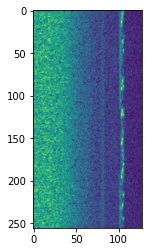

pibgre ['nocall']


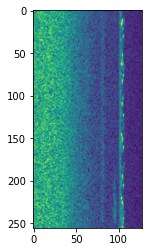

pibgre ['nocall']


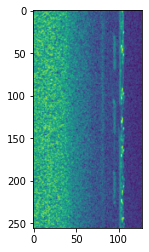

laugul ['nocall']


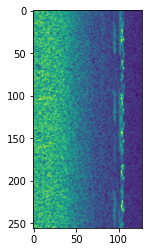

laugul ['nocall']


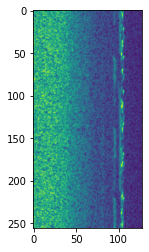

laugul ['nocall']


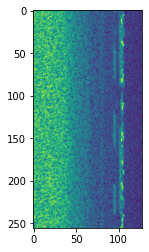

pibgre ['nocall']


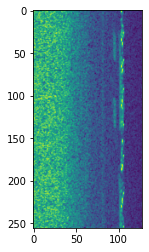

pibgre ['nocall']


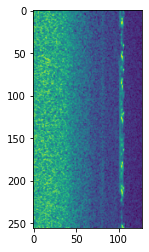

pibgre ['nocall']


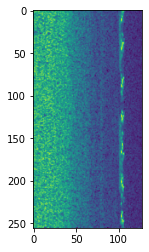

purgal2 ['nocall']


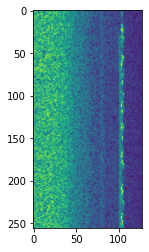

pibgre ['nocall']


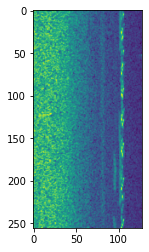

laugul ['nocall']


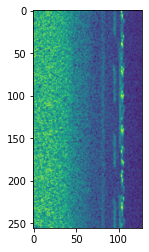

laugul ['nocall']


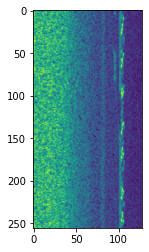

purgal2 ['nocall']


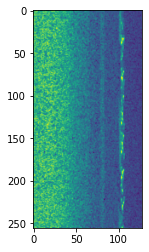

pibgre ['nocall']


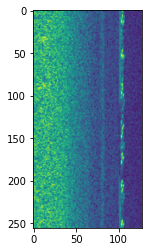

pibgre ['nocall']


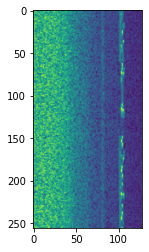

pibgre ['nocall']


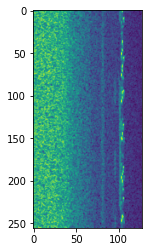

laugul ['nocall']


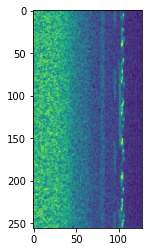

purgal2 ['nocall']


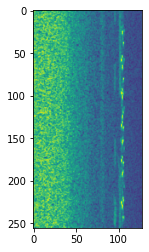

laugul ['nocall']


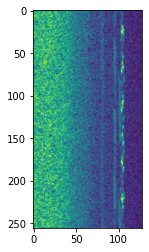

purgal2 ['nocall']


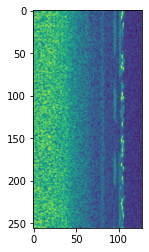

pibgre ['nocall']


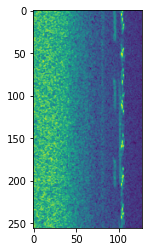

purgal2 ['nocall']


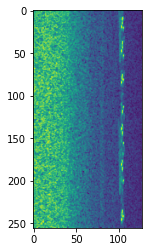

pibgre ['nocall']


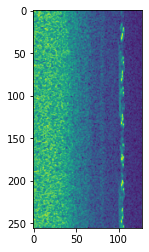

purgal2 ['nocall']


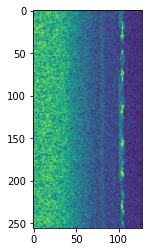

purgal2 ['nocall']


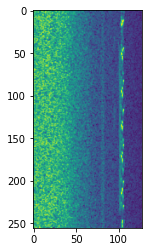

pibgre ['nocall']


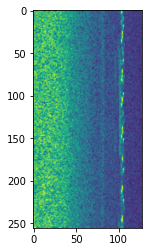

pibgre ['nocall']


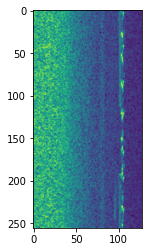

laugul ['nocall']


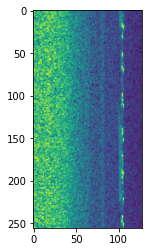

pibgre ['nocall']


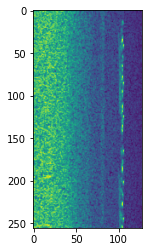

laugul ['nocall']


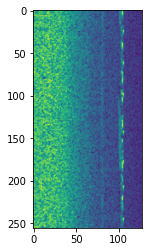

pibgre ['nocall']


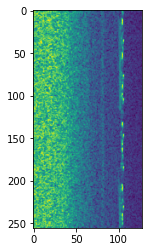

pibgre ['nocall']


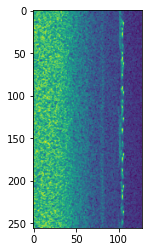

pibgre ['nocall']


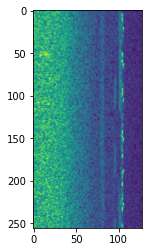

bbwduc ['nocall']


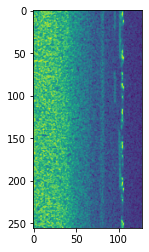

purgal2 ['nocall']


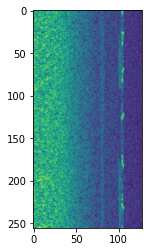

purgal2 ['nocall']


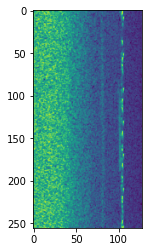

bbwduc ['nocall']


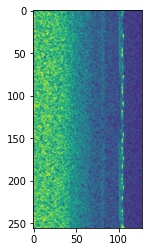

pibgre ['nocall']


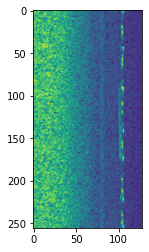

pibgre ['nocall']


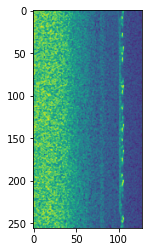

pibgre ['nocall']


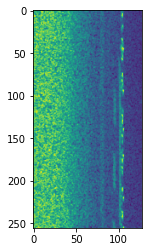

pibgre ['nocall']


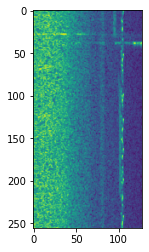

bbwduc ['nocall']


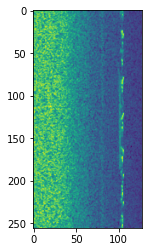

pibgre ['nocall']


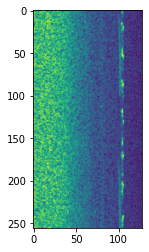

pibgre ['nocall']


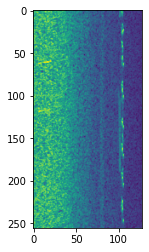

laugul ['nocall']


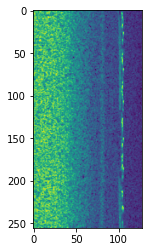

laugul ['nocall']


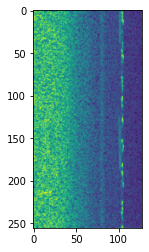

pibgre ['nocall']


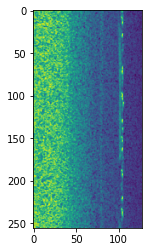

laugul ['nocall']


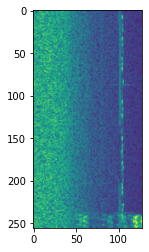

ccbfin ['nocall']


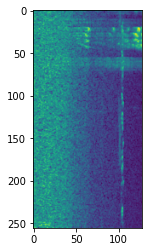

gwfgoo ['nocall']


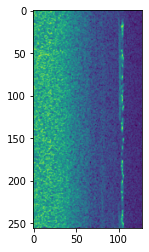

pibgre ['nocall']


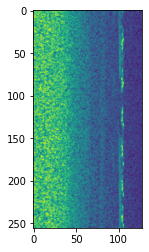

purgal2 ['nocall']


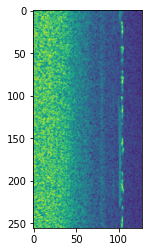

bbwduc ['nocall']


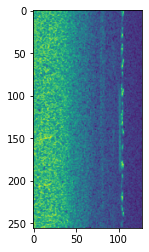

bbwduc ['nocall']


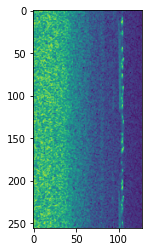

laugul ['nocall']


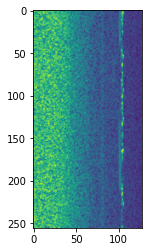

bbwduc ['nocall']


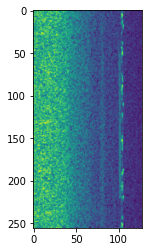

laugul ['nocall']


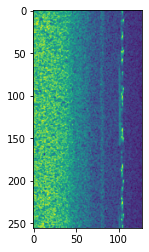

pibgre ['nocall']


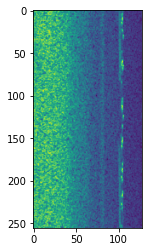

pibgre ['nocall']


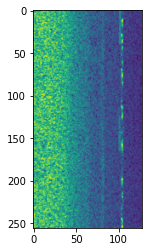

pibgre ['nocall']


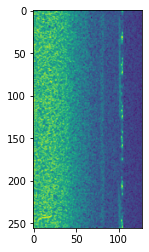

purgal2 ['nocall']


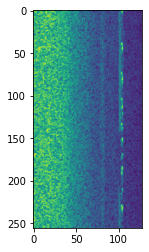

pibgre ['nocall']


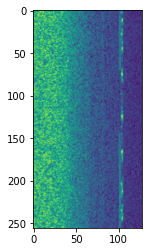

pibgre ['nocall']


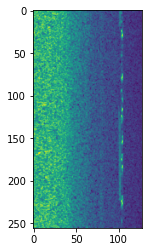

purgal2 ['nocall']


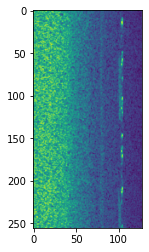

pibgre ['nocall']


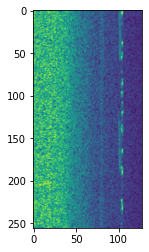

purgal2 ['nocall']


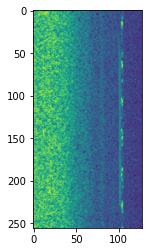

pibgre ['nocall']


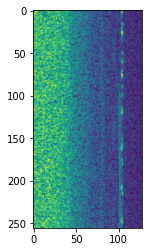

pibgre ['nocall']


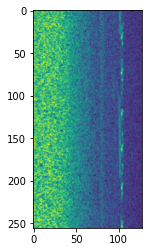

pibgre ['nocall']


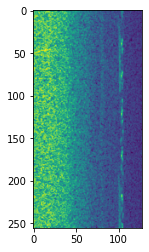

bbwduc ['nocall']


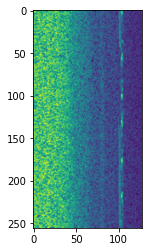

bbwduc ['nocall']


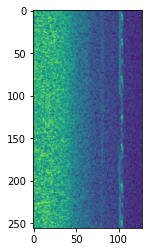

coohaw ['nocall']


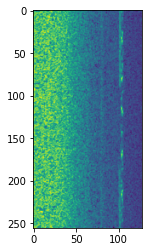

pibgre ['nocall']


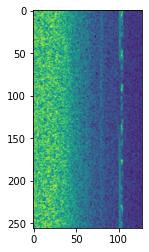

pibgre ['nocall']


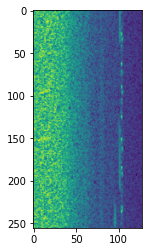

bbwduc ['nocall']


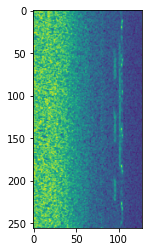

pibgre ['nocall']


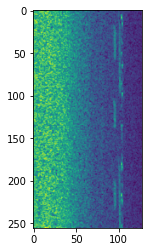

bbwduc ['nocall']


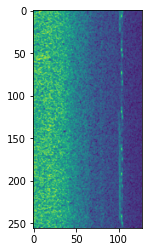

bbwduc ['nocall']


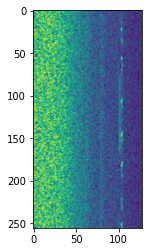

pibgre ['nocall']


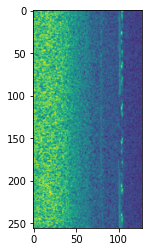

pibgre ['nocall']


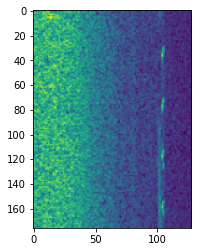

bbwduc ['nocall']


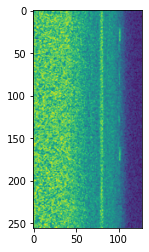

bbwduc ['nocall']


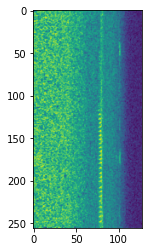

coohaw ['nocall']


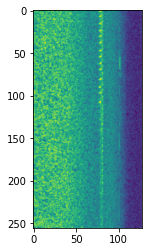

coohaw ['nocall']


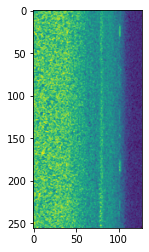

bbwduc ['nocall']


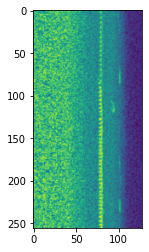

coohaw ['nocall']


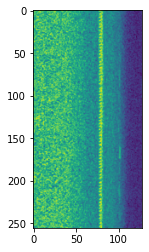

bbwduc ['nocall']


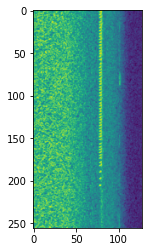

bbwduc ['nocall']


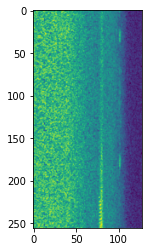

coohaw ['nocall']


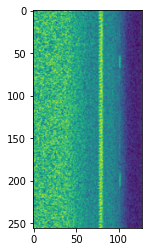

coohaw ['nocall']


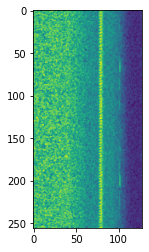

coohaw ['nocall']


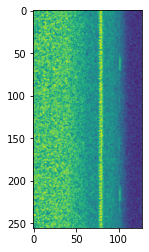

coohaw ['nocall']


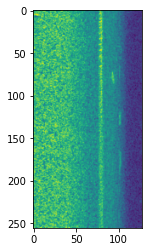

bbwduc ['nocall']


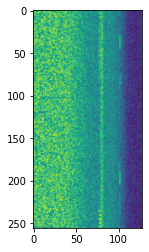

bbwduc ['nocall']


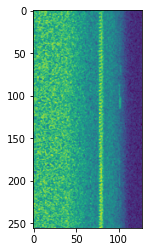

coohaw ['nocall']


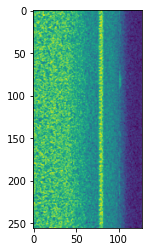

coohaw ['nocall']


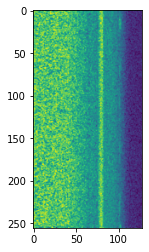

coohaw ['nocall']


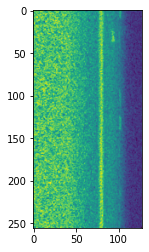

bbwduc ['nocall']


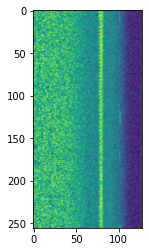

coohaw ['nocall']


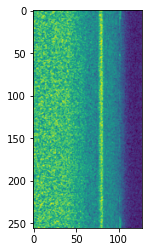

coohaw ['nocall']


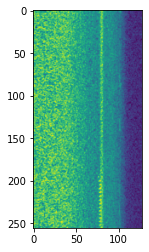

coohaw ['nocall']


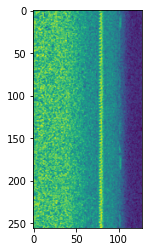

coohaw ['nocall']


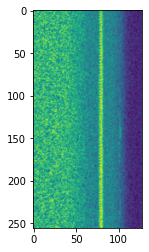

coohaw ['nocall']


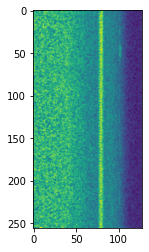

coohaw ['nocall']


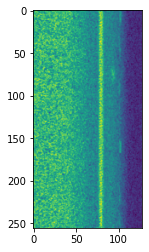

bbwduc ['nocall']


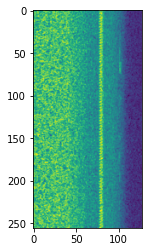

coohaw ['nocall']


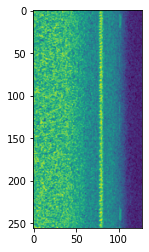

bbwduc ['nocall']


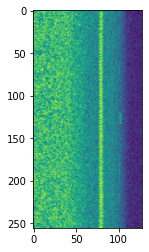

coohaw ['nocall']


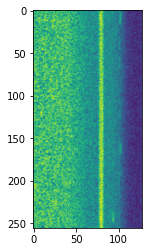

coohaw ['nocall']


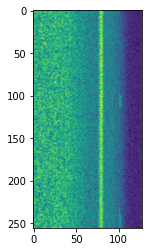

coohaw ['nocall']


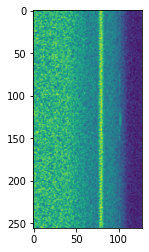

coohaw ['nocall']


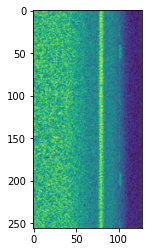

coohaw ['nocall']


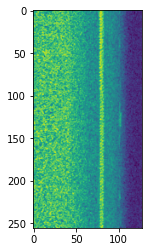

coohaw ['nocall']


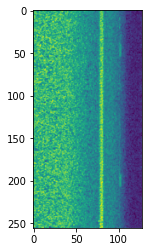

coohaw ['nocall']


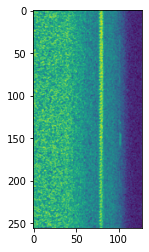

coohaw ['nocall']


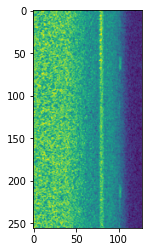

coohaw ['nocall']


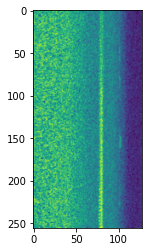

coohaw ['nocall']


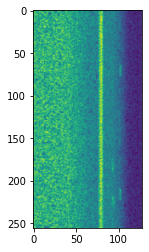

coohaw ['nocall']


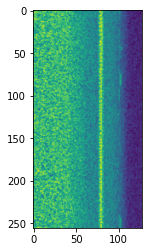

coohaw ['nocall']


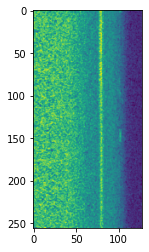

coohaw ['nocall']


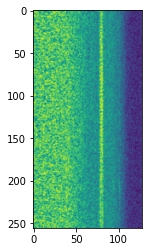

coohaw ['nocall']


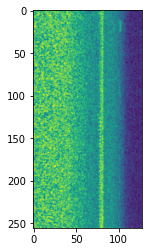

laugul ['nocall']


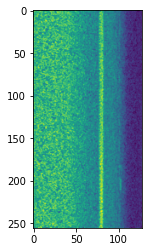

coohaw ['nocall']


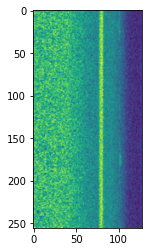

coohaw ['nocall']


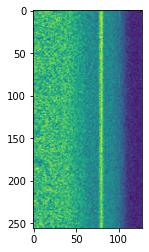

coohaw ['nocall']


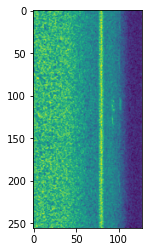

coohaw ['nocall']


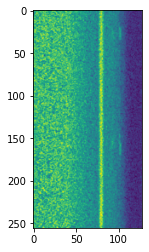

coohaw ['nocall']


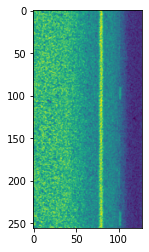

coohaw ['nocall']


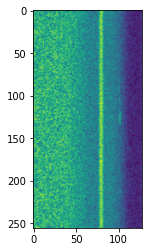

coohaw ['nocall']


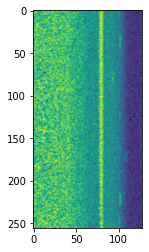

coohaw ['nocall']


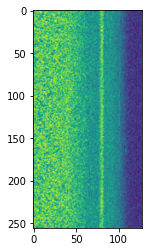

coohaw ['nocall']


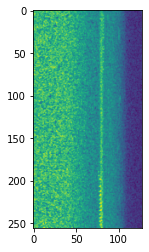

coohaw ['nocall']


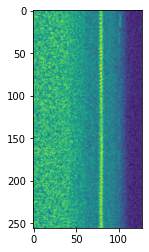

coohaw ['nocall']


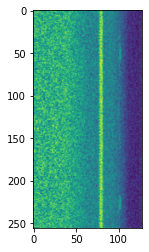

marwre ['nocall']


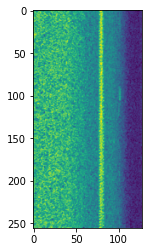

coohaw ['nocall']


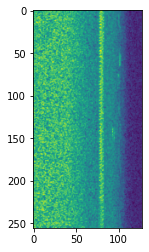

coohaw ['nocall']


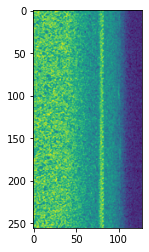

bbwduc ['nocall']


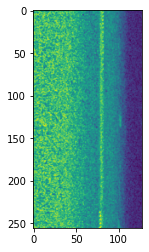

coohaw ['nocall']


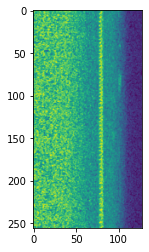

coohaw ['nocall']


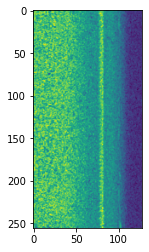

coohaw ['nocall']


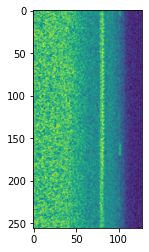

coohaw ['nocall']


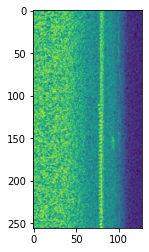

bbwduc ['nocall']


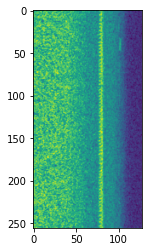

coohaw ['nocall']


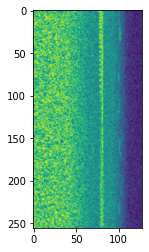

coohaw ['nocall']


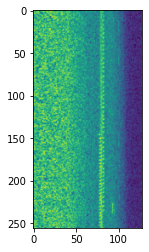

coohaw ['nocall']


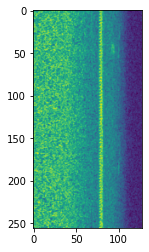

coohaw ['nocall']


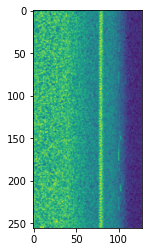

coohaw ['nocall']


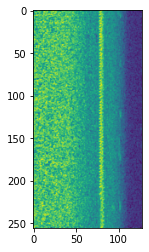

coohaw ['nocall']


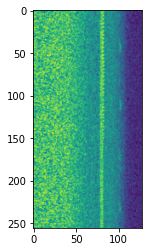

coohaw ['nocall']


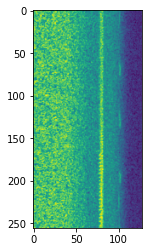

coohaw ['nocall']


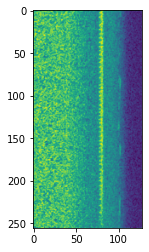

coohaw ['nocall']


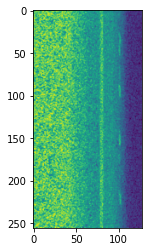

bbwduc ['nocall']


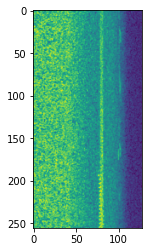

coohaw ['nocall']


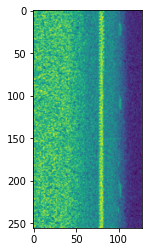

coohaw ['nocall']


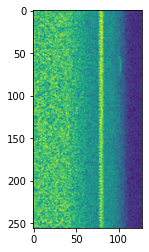

coohaw ['nocall']


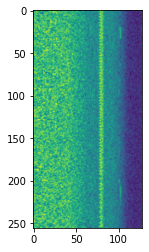

coohaw ['nocall']


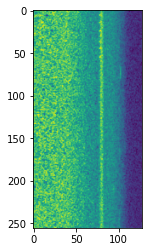

coohaw ['nocall']


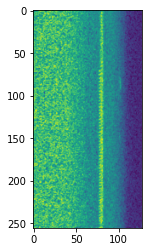

wilsni1 ['nocall']


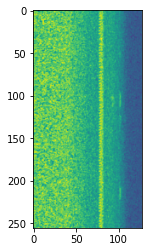

coohaw ['nocall']


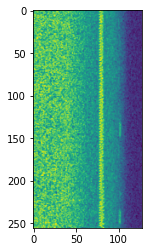

bbwduc ['nocall']


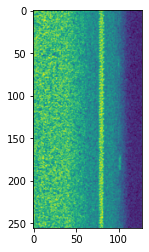

coohaw ['nocall']


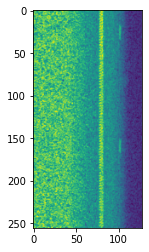

coohaw ['nocall']


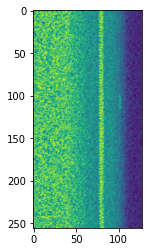

coohaw ['nocall']


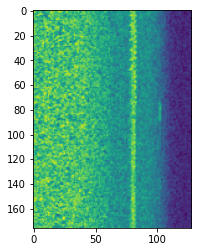

coohaw ['nocall']


KeyboardInterrupt: 

In [25]:
import matplotlib.pyplot as plt


#model = LittleModel('resnest50')
model = getattr(resnest_torch, 'resnest50')(pretrained=False, num_classes=397)
model.load_state_dict(torch.load('./result/resnest50_pri2.pth',map_location=device))
model.to(device)

model.eval()
call_list, blist = load_Metadata()
classes_list = np.array(blist)

for scape in scape_list:
    wav, _ = librosa.load(os.path.join(path,scape))
    target = '_'.join(scape.split('_')[:2])
    
    for frame,birds in zip(range(0,len(wav),term),scape_dict[target]):
        
        clip = torch.from_numpy(wav[frame:frame+term]).unsqueeze(0).to(device)
        clip = extractor(clip)
        clip = clip.cpu().detach().numpy().T
        clip = mono_to_color(clip).T/255
        clip = torch.from_numpy(clip).to(torch.float32).to(device)
        clip = torch.tile(clip,(1,3,1,1))
        plt.imshow(clip[0,0].cpu())
        plt.show()
        
        temp = convert_to_mel(wav[frame:frame+term])
        result = model(clip)
        result = result.cpu().detach().numpy()[0]
        
        print(classes_list[result.argmax()],birds)

In [ ]:
plt.imshow(clip[0,0].cpu())

In [ ]:
criterion = nn.BCEWithLogitsLoss()

for batch,data in enumerate(train_dataloader):
    wav, bird = data
      
    wav = wav.to(torch.float32)
    wav = wav.to(device)
    bird_smooth = np.where(bird==1,0.995,0.0025)
    bird_smooth = torch.from_numpy(bird_smooth).to(device)

    output = model(wav).float()  # sigmoid will be done in loss !
    loss = criterion(output, bird_smooth)
    
    print(loss)
    print(classes_list[output[0].cpu().detach().numpy() >0.3], classes_list[bird[0]>0.3]) 

In [29]:
net = resnest50(pretrained=False)
#net = EfficientNet.from_pretrained('efficientnet-b0')
net.fc = nn.Linear(net.fc.in_features, 397)


path = './train_data/kk/resnest50_sr32000_d7_v1_v1/birdclef_resnest50_fold2_epoch_19_f1_val_07711_20210524070826.pth'
d = torch.load(path, map_location=device)
for key in list(d.keys()):
    d[key.replace("model.", "")] = d.pop(key)
net.load_state_dict(d)

<All keys matched successfully>

In [31]:
net

ResNet(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): SplAtConv2d(
        (conv): Conv2d

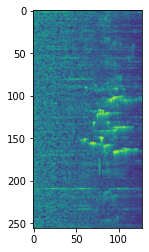

[] ['bkcchi grycat reevir1']


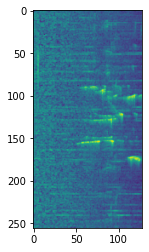

[] ['eawpew grycat reevir1']


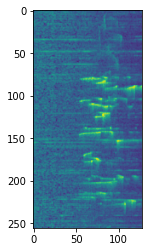

[] ['bkcchi eawpew grycat reevir1']


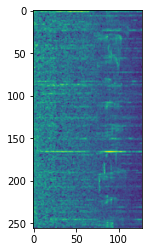

[] ['eawpew grycat reevir1']


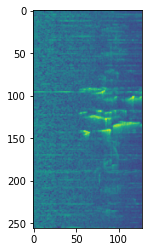

[] ['eawpew grycat reevir1']


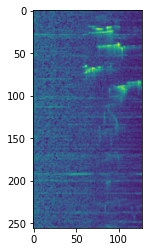

[] ['bkcchi reevir1']


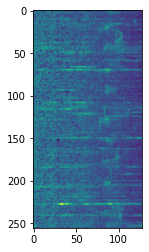

[] ['eawpew grycat reevir1']


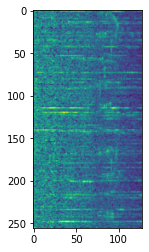

[] ['bkcchi eawpew grycat reevir1']


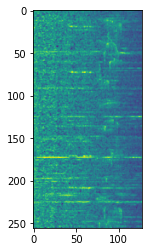

[] ['eawpew reevir1']


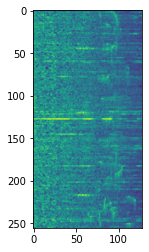

[] ['bkcchi eawpew reevir1']


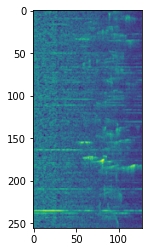

[] ['bkcchi eawpew reevir1']


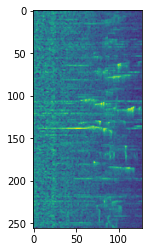

[] ['bkcchi eawpew reevir1']


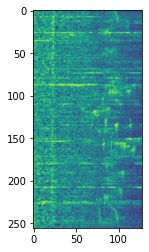

[] ['bkcchi eawpew reevir1']


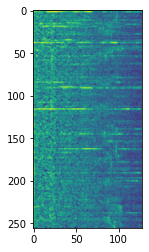

[] ['eawpew reevir1']


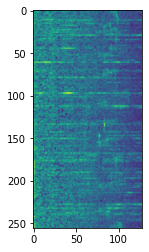

[] ['bkcchi eawpew grycat reevir1']


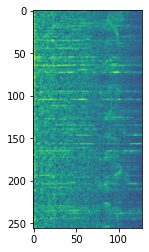

[] ['eawpew grycat reevir1']


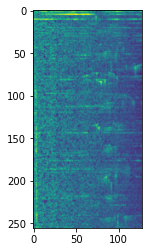

[] ['grycat reevir1']


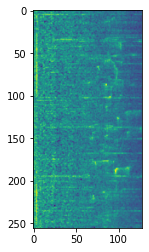

[] ['eawpew grycat reevir1']


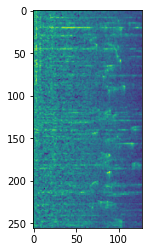

[] ['eawpew grycat reevir1']


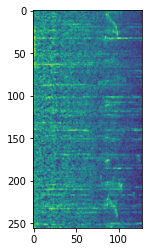

[] ['bkcchi reevir1']


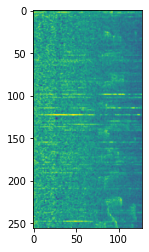

[] ['eawpew reevir1']


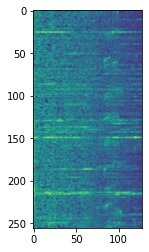

[] ['bkcchi eawpew reevir1']


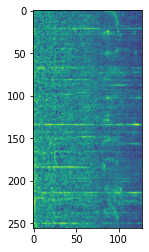

[] ['eawpew reevir1']


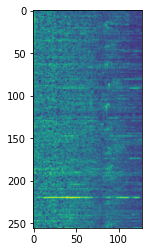

[] ['reevir1']


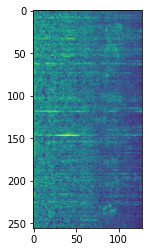

[] ['bkcchi eawpew reevir1']


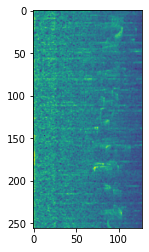

[] ['grycat reevir1']


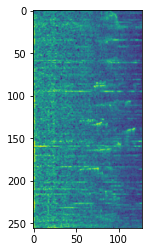

[] ['eawpew grycat reevir1']


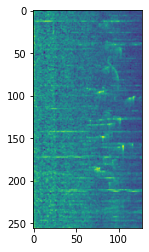

[] ['eawpew grycat reevir1']


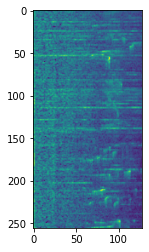

[] ['eawpew reevir1']


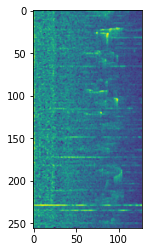

[] ['reevir1']


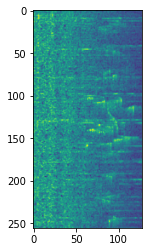

[] ['eawpew reevir1']


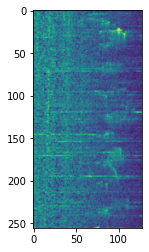

[] ['eawpew reevir1']


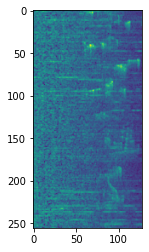

[] ['reevir1']


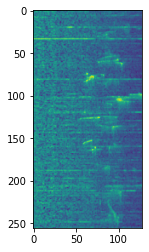

[] ['eawpew reevir1']


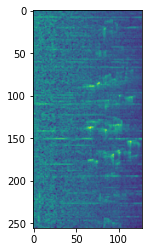

[] ['eawpew reevir1']


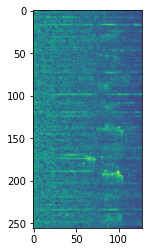

[] ['reevir1']


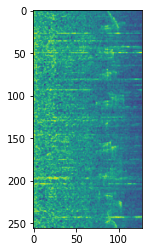

[] ['eawpew grycat reevir1']


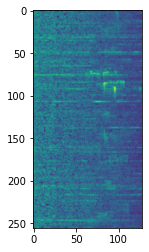

[] ['eawpew grycat reevir1']


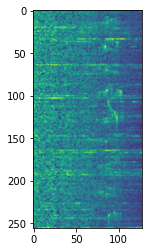

[] ['grycat reevir1']


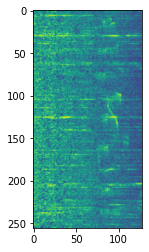

[] ['eawpew grycat reevir1']


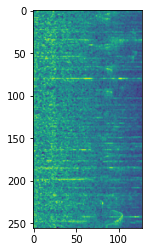

[] ['grycat reevir1']


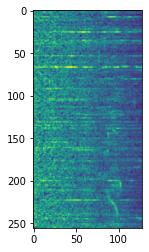

['bnhcow'] ['eawpew grycat reevir1']


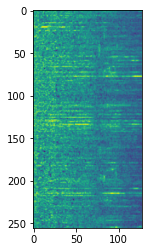

[] ['grycat reevir1']


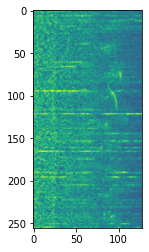

[] ['eawpew grycat reevir1']


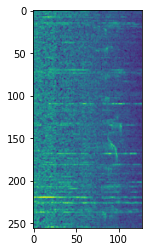

[] ['eawpew grycat reevir1']


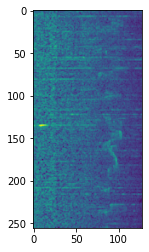

[] ['chswar eawpew grycat reevir1']


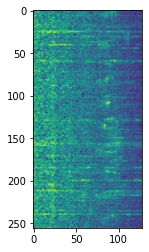

[] ['grycat reevir1']


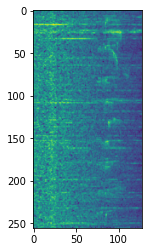

[] ['chswar eawpew reevir1']


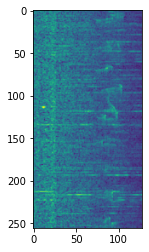

[] ['grycat reevir1']


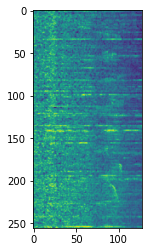

[] ['eawpew grycat reevir1']


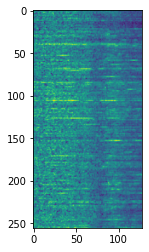

[] ['grycat reevir1']


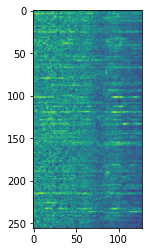

[] ['grycat reevir1']


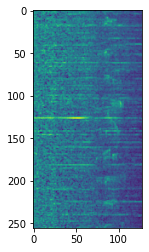

[] ['eawpew reevir1']


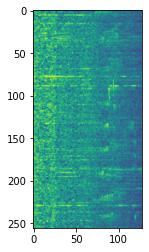

[] ['eawpew reevir1']


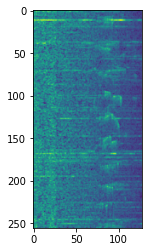

[] ['bkcchi grycat reevir1']


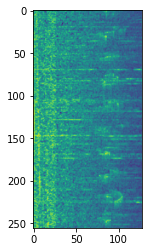

[] ['eawpew reevir1']


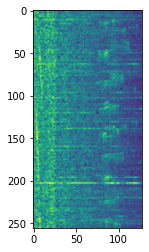

[] ['reevir1']


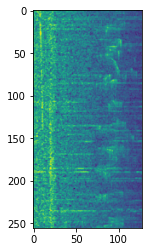

[] ['eawpew reevir1']


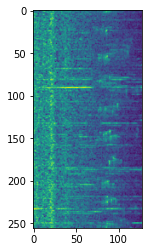

[] ['reevir1']


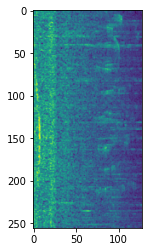

[] ['eawpew reevir1']


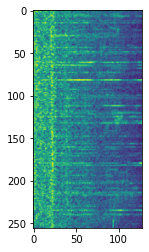

[] ['eawpew reevir1']


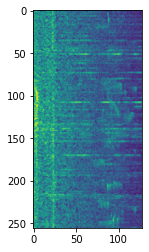

[] ['bkcchi reevir1']


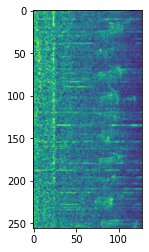

[] ['eawpew reevir1']


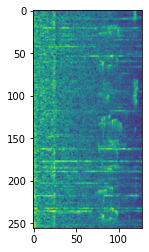

[] ['reevir1']


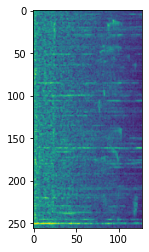

[] ['eawpew reevir1']


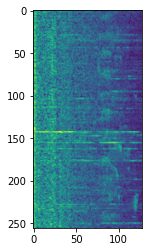

[] ['reevir1']


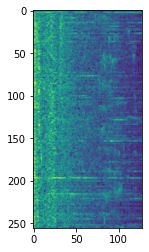

[] ['eawpew reevir1']


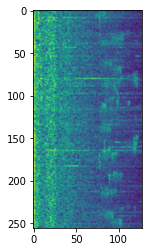

[] ['reevir1']


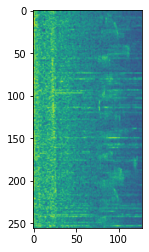

[] ['eawpew reevir1']


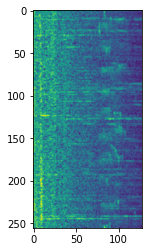

[] ['reevir1']


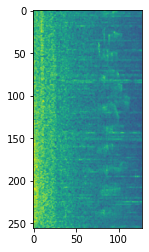

[] ['eawpew reevir1']


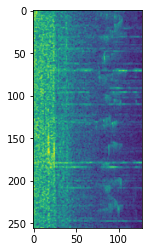

[] ['reevir1']


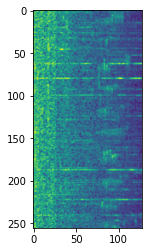

[] ['eawpew reevir1']


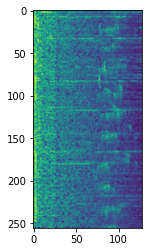

[] ['reevir1']


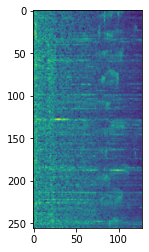

[] ['reevir1']


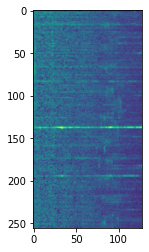

[] ['reevir1']


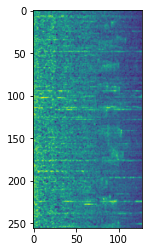

[] ['eawpew reevir1']


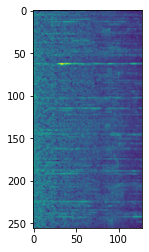

[] ['bkcchi reevir1']


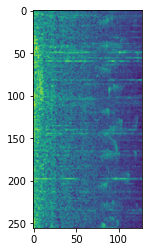

[] ['eawpew reevir1']


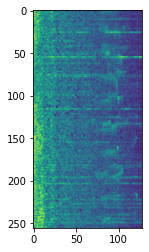

[] ['reevir1']


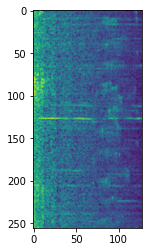

[] ['eawpew reevir1']


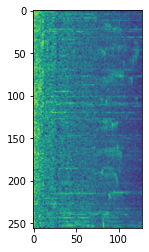

[] ['reevir1']


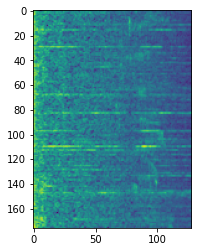

[] ['eawpew reevir1']


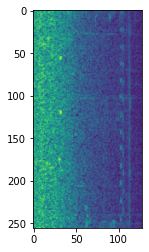

[] ['nocall']


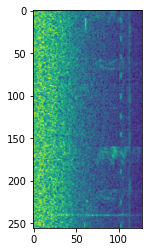

[] ['bobfly1']


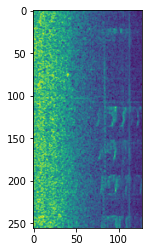

[] ['nocall']


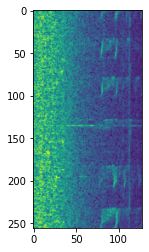

[] ['bobfly1']


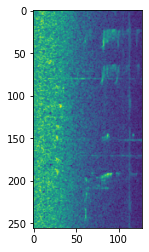

[] ['bobfly1']


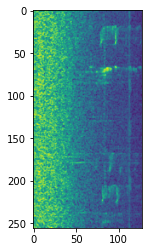

[] ['bobfly1']


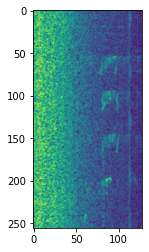

[] ['bobfly1']


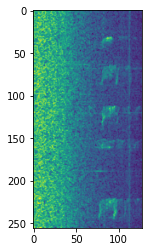

[] ['bobfly1']


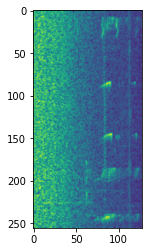

[] ['bobfly1']


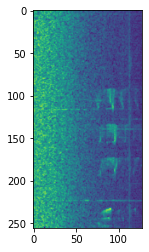

[] ['bobfly1']


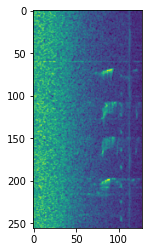

[] ['bobfly1']


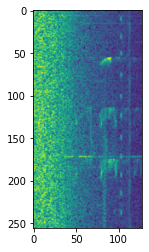

[] ['bobfly1']


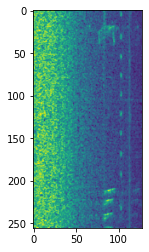

[] ['bobfly1']


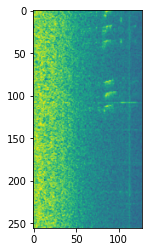

[] ['bobfly1']


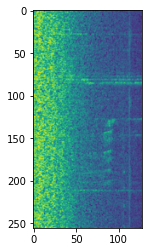

[] ['bobfly1']


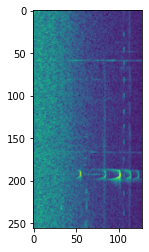

[] ['bobfly1']


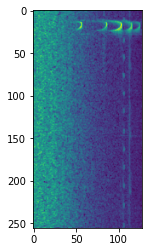

[] ['bobfly1']


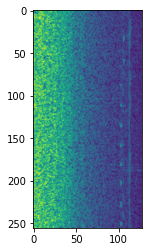

[] ['nocall']


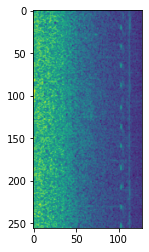

[] ['bobfly1']


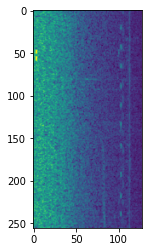

[] ['bobfly1']


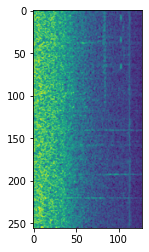

[] ['nocall']


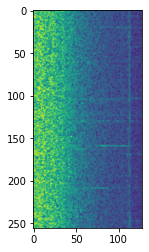

[] ['bobfly1']


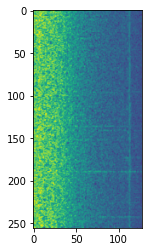

[] ['grekis']


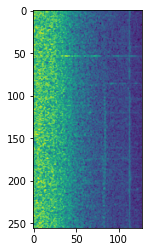

[] ['grekis']


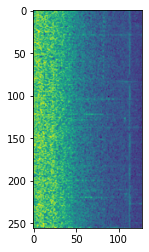

[] ['nocall']


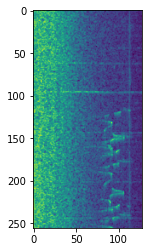

[] ['nocall']


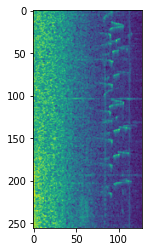

[] ['nocall']


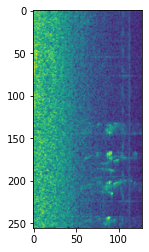

[] ['nocall']


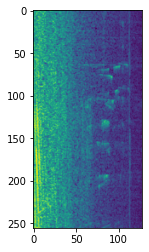

[] ['nocall']


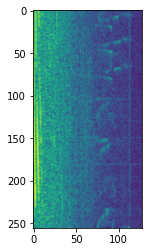

[] ['nocall']


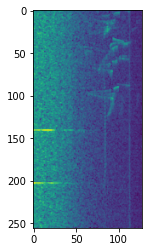

[] ['nocall']


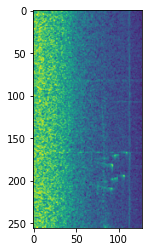

[] ['nocall']


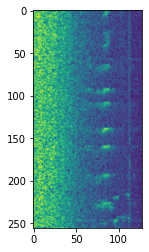

[] ['nocall']


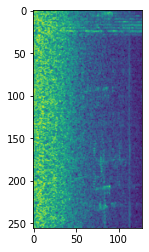

[] ['nocall']


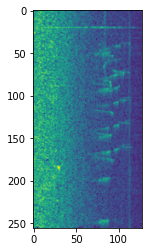

[] ['nocall']


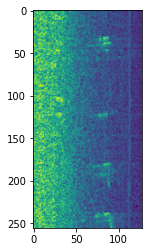

[] ['nocall']


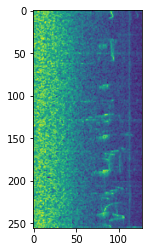

[] ['nocall']


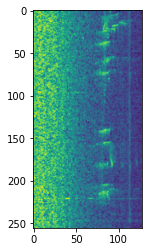

[] ['plawre1']


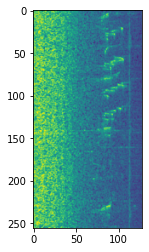

[] ['plawre1']


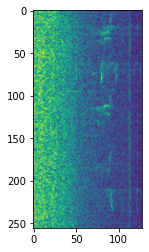

[] ['bobfly1 plawre1']


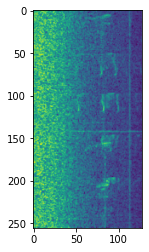

[] ['bobfly1 plawre1']


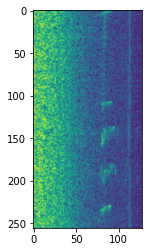

[] ['bobfly1 plawre1']


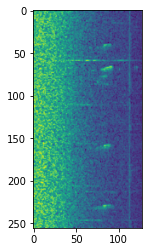

[] ['bobfly1 plawre1']


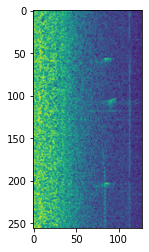

[] ['bobfly1 plawre1']


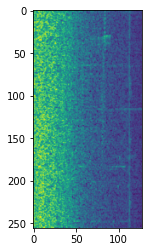

[] ['nocall']


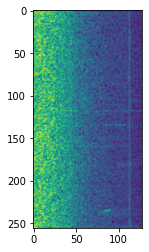

[] ['plawre1']


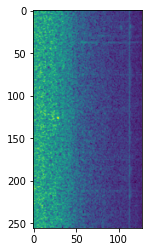

[] ['bobfly1 plawre1']


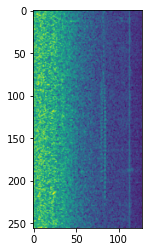

[] ['bobfly1']


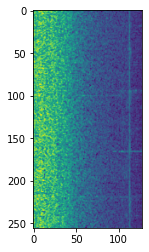

[] ['nocall']


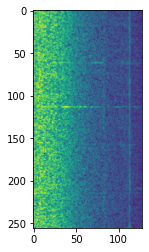

[] ['plawre1']


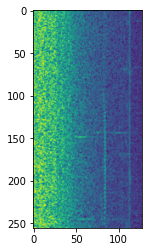

[] ['bobfly1 plawre1']


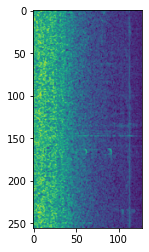

[] ['bobfly1']


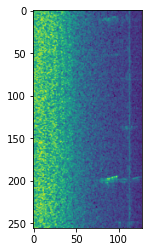

[] ['bobfly1']


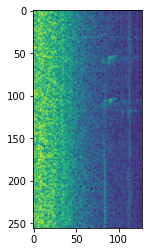

[] ['bobfly1']


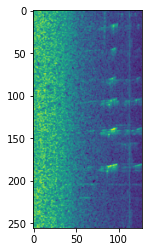

[] ['bobfly1']


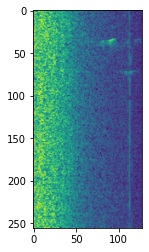

[] ['bobfly1 plawre1']


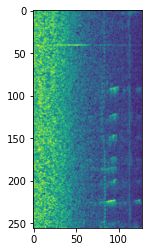

[] ['bobfly1']


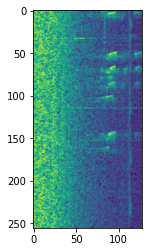

[] ['bobfly1']


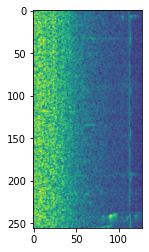

[] ['bobfly1']


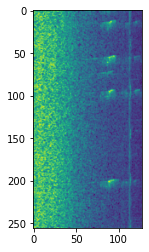

[] ['bobfly1']


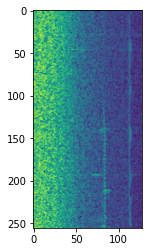

[] ['bobfly1']


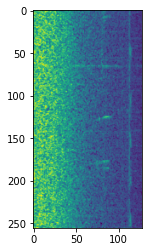

[] ['bobfly1']


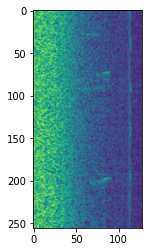

[] ['bobfly1']


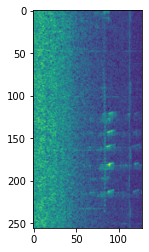

[] ['bobfly1']


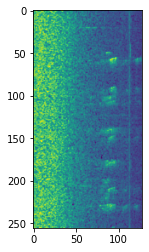

[] ['nocall']


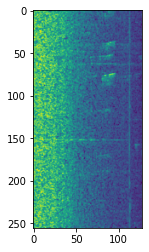

[] ['nocall']


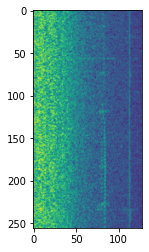

[] ['nocall']


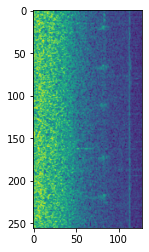

[] ['nocall']


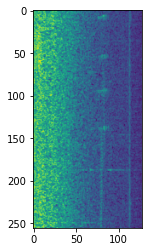

[] ['nocall']


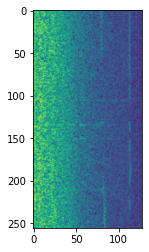

[] ['nocall']


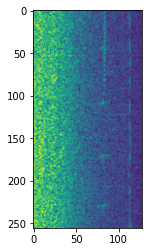

[] ['nocall']


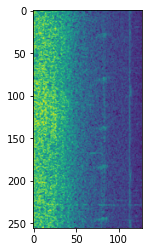

[] ['nocall']


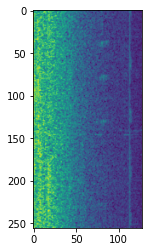

[] ['nocall']


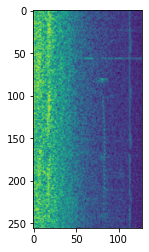

[] ['nocall']


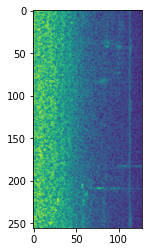

[] ['nocall']


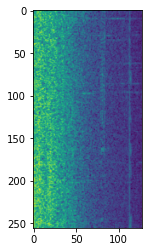

[] ['nocall']


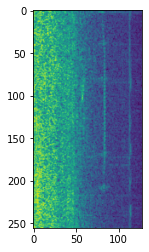

[] ['bobfly1']


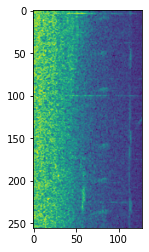

[] ['bobfly1']


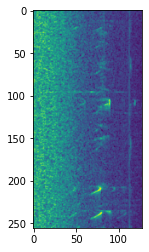

[] ['bobfly1']


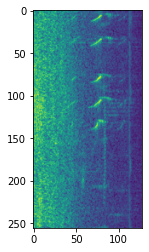

[] ['bobfly1']


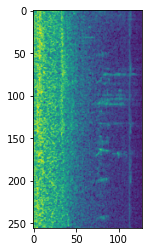

[] ['nocall']


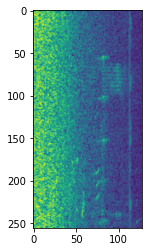

[] ['bobfly1']


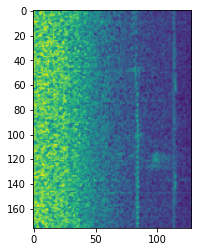

[] ['bobfly1']


KeyboardInterrupt: 

In [41]:
import matplotlib.pyplot as plt

net = resnest50(pretrained=False)
#net = EfficientNet.from_pretrained('efficientnet-b0')
net.fc = nn.Linear(net.fc.in_features, 397)


pthpath = './train_data/kk/resnest50_sr32000_d7_v1_v1/birdclef_resnest50_fold2_epoch_19_f1_val_07711_20210524070826.pth'
d = torch.load(pthpath, map_location=device)
for key in list(d.keys()):
    d[key.replace("model.", "")] = d.pop(key)
net.load_state_dict(d)
net.to(device)
net.eval()
call_list, blist = load_Metadata()
classes_list = np.array(blist)

for scape in scape_list:
    wav, _ = librosa.load(os.path.join(path,scape))
    target = '_'.join(scape.split('_')[:2])
    
    for frame,birds in zip(range(0,len(wav),term),scape_dict[target]):
        
        clip = torch.from_numpy(wav[frame:frame+term]).unsqueeze(0).to(device)
        clip = extractor(clip)
        clip = clip.cpu().detach().numpy().T
        clip = mono_to_color(clip).T/255
        clip = torch.from_numpy(clip).to(torch.float32).to(device)
        clip = torch.tile(clip,(1,3,1,1))
        plt.imshow(clip[0,0].cpu())
        plt.show()
        
        temp = convert_to_mel(wav[frame:frame+term])
        result = net(clip)
        result = result.cpu().detach().numpy()[0]
        
        print(classes_list[result>0.3],birds)

In [42]:
result

array([-6.7003703, -3.275132 , -6.198934 , -6.182819 , -5.668903 ,
       -7.4658084, -5.973799 , -6.8483133, -5.17275  , -4.8734465,
       -5.7955766, -5.712119 , -4.2588058, -7.191249 , -6.1435094,
       -6.170091 , -7.1289186, -5.4048953, -5.1383915, -5.529658 ,
       -6.680576 , -6.9162307, -6.4077682, -6.4446516, -5.860125 ,
       -6.4179587, -5.4374185, -6.1272383, -7.0037537, -6.1308923,
       -5.2240586, -6.222842 , -4.924367 , -6.1258855, -7.572989 ,
       -4.361269 , -7.1694856, -7.5208187, -6.6235566, -6.482192 ,
       -3.8336542, -5.4620924, -6.718704 , -6.029808 , -5.8973455,
       -6.471199 , -6.633145 , -5.0280695, -4.96992  , -6.8302436,
       -6.4433055, -5.7991233, -6.079509 , -5.346563 , -6.193025 ,
       -5.9812384, -5.114632 , -6.552367 , -6.951987 , -6.226561 ,
       -6.6674876, -6.368556 , -6.76931  , -5.220764 , -6.122591 ,
       -4.1894174, -7.0860286, -6.4929514, -6.8525257, -5.185488 ,
       -5.605316 , -6.538292 , -6.3613725, -6.648317 , -5.6661